<a href="https://colab.research.google.com/github/jessicamotam/AvantiBootcamp_ML/blob/main/ML_Projeto_PARTE_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install imantics --quiet
!apt-get install

  Preparing metadata (setup.py) ... done
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from PIL import Image
from skimage.transform import resize
from sklearn.model_selection import train_test_split
%matplotlib inline
from tensorflow.keras import mixed_precision

In [ ]:
from tensorflow.keras import mixed_precision
print(mixed_precision)


# IMPORTAÇÃO mixed_precision da biblioteca tensorflow.keras, que é usado para melhorar o desempenho em modelos de aprendizado profundo

<module 'keras.api.mixed_precision' from '/usr/local/lib/python3.10/dist-packages/keras/api/mixed_precision/__init__.py'>


In [ ]:
pip install tensorflow==2.18.0

In [ ]:
!pip install opendatasets

In [ ]:
import opendatasets as od
import os

# Baixar o dataset
od.download("https://www.kaggle.com/datasets/maedemaftouni/covid19-ct-scan-lesion-segmentation-dataset/data")

# Definir o diretório onde o dataset foi baixado
dataset_dir = './covid19-ct-scan-lesion-segmentation-dataset/frames'

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: jessicamotam
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/maedemaftouni/covid19-ct-scan-lesion-segmentation-dataset


100%|██████████| 688M/688M [00:33<00:00, 21.5MB/s]


In [ ]:
images_dir ='./covid19-ct-scan-lesion-segmentation-dataset/frames'   # pega as imagens da IMAGES_DIR = FRAMES
masks_dir = './covid19-ct-scan-lesion-segmentation-dataset/masks'    # MASKS_DIR = MASKS

print(images_dir)

./covid19-ct-scan-lesion-segmentation-dataset/frames


In [ ]:
images_listdir = os.listdir(images_dir)
masks_listdir = os.listdir(masks_dir)

### Imagem da pasta FRAMES

(512, 512, 3)


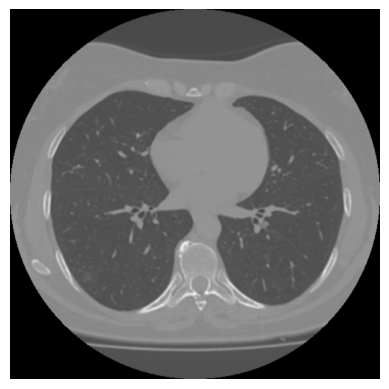

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to your image file
image_path = f"{images_dir}/{images_listdir[3]}"
# Load the image
image = mpimg.imread(image_path)
print(image.shape)
# Display the image
plt.imshow(image)
plt.axis('off')  # Optional: Turn off axis labels
plt.show()

### Imagem da pasta MASKS

(512, 512, 3)


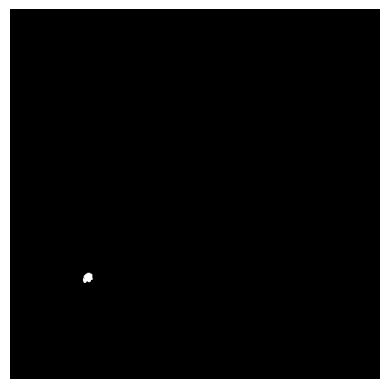

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to your image file
image_path = f"{masks_dir}/{masks_listdir[3]}"
# Load the image
image = mpimg.imread(image_path)
print(image.shape)
# Display the image
plt.imshow(image)
plt.axis('off')  # Optional: Turn off axis labels
plt.show()

In [ ]:
image_paths=[f"{images_dir}/{i}" for i in images_listdir[0:1000]]
mask_paths=[f"{masks_dir}/{i}" for i in masks_listdir[0:1000]]

In [ ]:
print(len(image_paths))
print(len(mask_paths))

1000
1000


In [ ]:
def get_image(path):
    image_path = path
    image = mpimg.imread(image_path)
    return image

    #Esse código define uma função chamada get_image, que carrega uma imagem a partir de um caminho especificado e a retorna.
    #A função retorna o objeto image, que representa a imagem carregada. Esse objeto pode ser usado para exibir ou processar a imagem.

### Checking unique values in 3 channels in the image and mask (!!! não entendi o que são esses 3 canais??!!)

# **Canais de uma Imagem**


Uma imagem digital é composta por uma grade de pixels, e cada pixel pode conter informações sobre cor. Os canais são as diferentes componentes de cor que compõem cada pixel. Aqui estão alguns exemplos comuns:


--> Imagem RGB:

-R (Red): Canal vermelho.
-G (Green): Canal verde.
-B (Blue): Canal azul.


Uma imagem RGB tem três canais. Cada canal armazena valores que representam a intensidade da respectiva cor em cada pixel. O valor de cada canal geralmente varia de 0 a 255 (para imagens de 8 bits), onde 0 significa nenhuma intensidade e 255 significa máxima intensidade.
Imagem em Escala de Cinza:


Uma imagem em escala de cinza tem apenas um canal, que representa a intensidade da luz (de preto a branco).
Outros Formatos:


Imagens com outros espaços de cor (como RGBA, que inclui um canal alfa para transparência) têm canais adicionais.

In [ ]:
ct_img=get_image(image_paths[0])
mask=get_image(mask_paths[0])

In [ ]:
print(ct_img.shape)
print(mask.shape)

(512, 512, 3)
(512, 512, 3)


###  Verifica e mostra  os valores únicos presentes em cada imagem das pastas Frames e Masks

In [ ]:
# Check unique values in each channel for the first image
for i in range(3):
    unique_values = np.unique(ct_img[:, :, i])
    print(f"Unique values in channel {i} of ct_image: {unique_values}")

# Similarly for the predicted mask
for i in range(3):
    unique_values = np.unique(mask[:, :, i])
    print(f"Unique values in channel {i} of mask: {unique_values}")

Unique values in channel 0 of ct_image: [0.         0.00392157 0.01568628 0.01960784 0.02352941 0.02745098
 0.03137255 0.03529412 0.03921569 0.04313726 0.04705882 0.05098039
 0.05490196 0.05882353 0.0627451  0.06666667 0.07058824 0.07450981
 0.07843138 0.08235294 0.08627451 0.09019608 0.09411765 0.09803922
 0.22745098 0.23137255 0.23529412 0.23921569 0.24313726 0.24705882
 0.2509804  0.25490198 0.25882354 0.2627451  0.26666668 0.27058825
 0.27450982 0.2784314  0.28235295 0.28627452 0.2901961  0.29411766
 0.29803923 0.3019608  0.30588236 0.30980393 0.3137255  0.31764707
 0.32156864 0.3254902  0.32941177 0.33333334 0.3372549  0.34117648
 0.34509805 0.34901962 0.3529412  0.35686275 0.36078432 0.3647059
 0.36862746 0.37254903 0.3764706  0.38039216 0.38431373 0.3882353
 0.39215687 0.39607844 0.4        0.40392157 0.40784314 0.4117647
 0.41568628 0.41960785 0.42352942 0.42745098 0.43137255 0.43529412
 0.4392157  0.44313726 0.44705883 0.4509804  0.45490196 0.45882353
 0.4627451  0.46666667 0.

In [ ]:
from skimage.color import rgb2gray

def remove_channels(image):
    return rgb2gray(image)

(512, 512, 3)


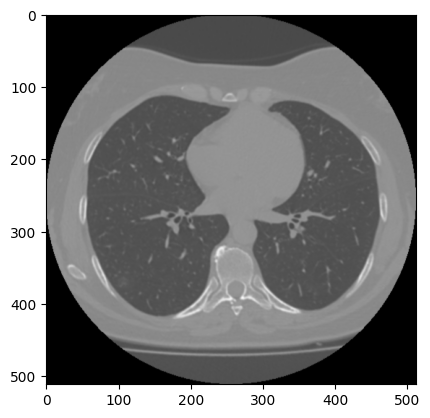

In [ ]:
image_3=get_image(image_paths[3])
print(image_3.shape)
plt.imshow(image_3)

(512, 512)


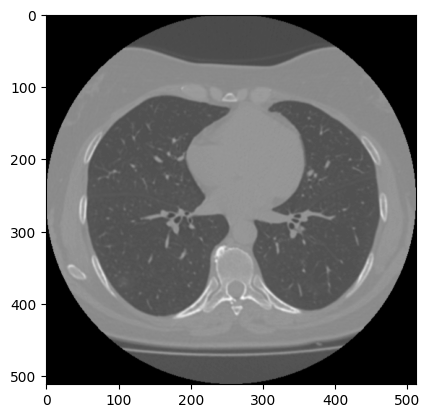

In [ ]:
image_1=remove_channels(image_3)
print(image_1.shape)
plt.imshow(image_1,cmap='gray')

In [ ]:
image=image_1[:,:,np.newaxis]
print(image.shape)

(512, 512, 1)


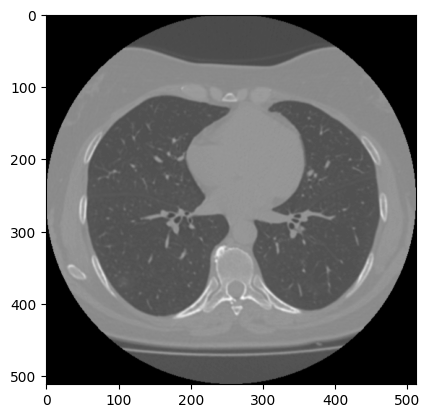

In [ ]:
plt.imshow(image,cmap='gray')

In [ ]:
ct_images=[remove_channels(get_image(path)) for path in image_paths]
ct_images=[image[:,:,np.newaxis] for image in ct_images]

In [ ]:
print(np.unique(ct_images[0]))

[0.         0.00392157 0.01568628 0.01960784 0.02352941 0.02745098
 0.03137255 0.03529412 0.03921569 0.04313726 0.04705882 0.05098039
 0.05490196 0.05882353 0.0627451  0.06666667 0.07058824 0.07450981
 0.07843138 0.08235294 0.08627451 0.09019607 0.09411765 0.09803922
 0.22745098 0.23137254 0.23529412 0.23921569 0.24313726 0.24705882
 0.2509804  0.25490198 0.25882354 0.2627451  0.26666668 0.27058825
 0.27450982 0.2784314  0.28235295 0.28627452 0.2901961  0.29411766
 0.29803923 0.3019608  0.30588233 0.30980393 0.3137255  0.31764704
 0.32156864 0.3254902  0.32941177 0.33333334 0.3372549  0.34117648
 0.34509805 0.34901962 0.3529412  0.35686275 0.3607843  0.3647059
 0.36862746 0.37254903 0.3764706  0.38039216 0.3843137  0.3882353
 0.39215687 0.3960784  0.4        0.40392157 0.40784314 0.4117647
 0.41568628 0.41960785 0.42352942 0.42745095 0.43137255 0.43529412
 0.43921566 0.44313726 0.44705883 0.45098037 0.45490196 0.45882353
 0.46274507 0.46666667 0.47058824 0.47450978 0.47843137 0.4823529

In [ ]:
masks=[get_image(path) for path in mask_paths]

In [ ]:
ct_images=np.array(ct_images)
masks = np.array(masks)
print(type(ct_images))
print(type(masks))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [ ]:
masks=masks[:,:,:,1]

In [ ]:
print(np.unique(masks))

[0.         0.04705882 0.06666667 0.08235294 1.        ]


In [ ]:
# Convert train_ct_images to float32
ct_images = ct_images.astype(np.float32)
ct_images=ct_images[:600]
masks=masks[:600]
# Convert train_masks to int32
masks = masks.astype(np.int32)

# Verify the data types
print("train_ct_images dtype:", ct_images.dtype)
print("train_masks dtype:", masks.dtype)

train_ct_images dtype: float32
train_masks dtype: int32


In [ ]:
ct_images.shape

(600, 512, 512, 1)

In [ ]:
print(np.unique(masks))

[0 1]


Spliting

In [ ]:
train_ct_images, test_ct_images, train_mask, test_mask = train_test_split(
    ct_images,masks, test_size=0.2, random_state=42
)


# Dice Coefficient Metric

Coeficiente de Dice (Dice Coefficient), uma métrica usada frequentemente para avaliar a sobreposição entre dois conjuntos, especialmente em tarefas de segmentação de imagens. Vou explicar o funcionamento detalhado do código.


Coeficiente de Dice é particularmente útil em tarefas de segmentação de imagens (como segmentação de células, órgãos, etc.), pois ajuda a medir quão bem a segmentação do modelo se alinha com a segmentação real.

In [ ]:
import tensorflow as tf
#Dice Coefficient Metric
def dice_coefficient(y_true, y_pred, smooth=1e-6):

    # Ensure both y_true and y_pred are float32
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)

    # Flatten the arrays to be 1D
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)

    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    union = tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f)

    return (2. * intersection + smooth) / (union + smooth)

In [ ]:
pip install tensorflow

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, BatchNormalization, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import mixed_precision

# Mixed Precision Setup
policy = mixed_precision.Policy('mixed_float16')
mixed_precision.set_global_policy(policy)

kernel_initializer = 'he_uniform'

def unet_plus_plus_model(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS):
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
    s = inputs

    # Contraction path
    c1 = Conv2D(32, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(s)
    c1 = BatchNormalization()(c1)
    c1 = Dropout(0.1)(c1)
    c1 = Conv2D(32, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(64, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(p1)
    c2 = BatchNormalization()(c2)
    c2 = Dropout(0.1)(c2)
    c2 = Conv2D(64, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(128, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(p2)
    c3 = BatchNormalization()(c3)
    c3 = Dropout(0.2)(c3)
    c3 = Conv2D(128, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(256, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(p3)
    c4 = BatchNormalization()(c4)
    c4 = Dropout(0.2)(c4)
    c4 = Conv2D(256, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(c4)

    # Upsampling path
    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c4)
    u6 = concatenate([u6, c3])
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(u6)
    c6 = BatchNormalization()(c6)
    c6 = Dropout(0.2)(c6)
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(c6)

    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c2])
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(u7)
    c7 = BatchNormalization()(c7)
    c7 = Dropout(0.1)(c7)
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(c7)

    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c1], axis=3)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(u8)
    c8 = BatchNormalization()(c8)
    c8 = Dropout(0.1)(c8)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer=kernel_initializer, padding='same')(c8)

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c8)

    model = Model(inputs=[inputs], outputs=[outputs])
    model.compile(optimizer=Adam(learning_rate=1e-5), loss='binary_crossentropy', metrics=['accuracy'])

    model.summary()

    return model

# Instantiate the model
model = unet_plus_plus_model(512, 512, 1)

# Example training loop
# Replace `train_data`, `train_labels`, `val_data`, and `val_labels` with your actual data
# model.fit(train_data, train_labels, epochs=20, batch_size=2, validation_data=(val_data, val_labels))

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 512, 512, 1)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ cast (Cast)               │ (None, 512, 512, 1)    │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 512, 512, 32)   │            320 │ cast[0][0]             │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 512, 512, 32)   │            128 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout (Dropout)         │ (None, 512, 512, 32)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 512, 512, 32)   │          9,248 │ dropout[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 256, 256, 32)   │              0 │ conv2d_1[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 256, 256, 64)   │         18,496 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 256, 256, 64)   │            256 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 256, 256, 64)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 256, 256, 64)   │         36,928 │ dropout_1[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_1           │ (None, 128, 128, 64)   │              0 │ conv2d_3[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 128, 128, 128)  │         73,856 │ max_pooling2d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 128, 128, 128)  │            512 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_2 (Dropout)       │ (None, 128, 128, 128)  │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 128, 128, 128)  │        147,584 │ dropout_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_2           │ (None, 64, 64, 128)    │              0 │ conv2d_5[0][0]         │
│ (MaxPooling2D)       

 Total params: 1,927,841 (7.35 MB)

 Trainable params: 1,926,433 (7.35 MB)

 Non-trainable params: 1,408 (5.50 KB)

In [ ]:
# Verificar a versão do TensorFlow
import tensorflow as tf
print(tf.__version__)


2.18.0


In [ ]:
pip install tensorflow-addons==0.20.0


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 591.0/591.0 kB 24.4 MB/s eta 0:00:00
  Attempting uninstall: typeguard
    Found existing installation: typeguard 4.4.1
    Uninstalling typeguard-4.4.1:
      Successfully uninstalled typeguard-4.4.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
inflect 7.4.0 requires typeguard>=4.0.1, but you have typeguard 2.13.3 which is incompatible.


In [ ]:
 pip install --upgrade tensorflow tensorflow-addons

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 3.0 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-addons
    Found existing installation: tensorflow-addons 0.20.0
    Uninstalling tensorflow-addons-0.20.0:
      Successfully uninstalled tensorflow-addons-0.20.0


In [ ]:
history = model.fit(
    train_ct_images,
    train_mask,  # Use the one-hot encoded masks
    validation_split=0.1,  # Use a fraction of the training data for validation
    batch_size=2,
    epochs=15,
    verbose=1
)

Epoch 1/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 84s 75ms/step - accuracy: 0.5524 - loss: 0.7471 - val_accuracy: 0.9723 - val_loss: 0.2887
Epoch 2/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 26s 49ms/step - accuracy: 0.9151 - loss: 0.3250 - val_accuracy: 0.9787 - val_loss: 0.1372
Epoch 3/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 20s 50ms/step - accuracy: 0.9705 - loss: 0.1872 - val_accuracy: 0.9836 - val_loss: 0.1008
Epoch 4/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 21s 51ms/step - accuracy: 0.9806 - loss: 0.1351 - val_accuracy: 0.9845 - val_loss: 0.0839
Epoch 5/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 21s 51ms/step - accuracy: 0.9828 - loss: 0.1080 - val_accuracy: 0.9847 - val_loss: 0.0738
Epoch 6/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 20s 50ms/step - accuracy: 0.9825 - loss: 0.0945 - val_accuracy: 0.9849 - val_loss: 0.0689
Epoch 7/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 11s 51ms/step - accuracy: 0.9849 - loss: 0.0755 - val_accuracy: 0.9849 - val_loss: 0.0646
Epoch 8/15
216/216 ━━━━━━━━━━━━━━━━━━━━ 20s 51ms/step - accuracy: 0.9847 - loss: 0.0700 - 

In [ ]:
tf.config.optimizer.set_jit(True)  # Disable JIT (XLA) compilation

In [ ]:
from tensorflow.keras import backend as K
import gc

K.clear_session()
gc.collect()

0

In [ ]:
from tensorflow.keras import mixed_precision

mixed_precision.set_global_policy('mixed_float16')

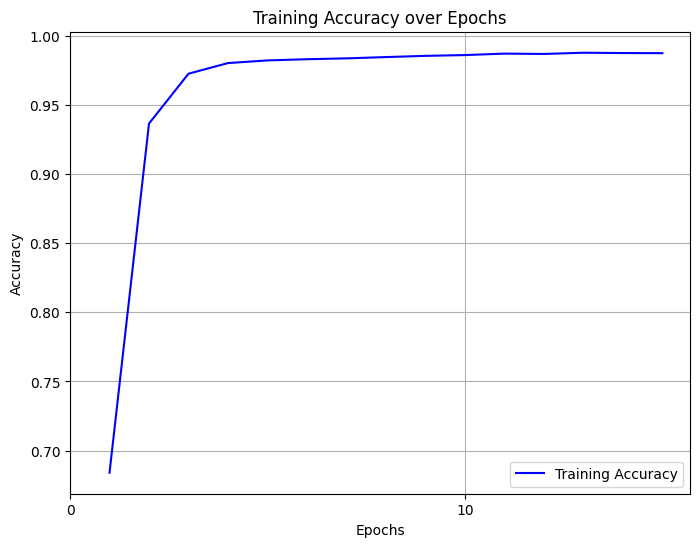

In [ ]:
import matplotlib.pyplot as plt

# Extract training accuracy from the history object
train_accuracy = history.history['accuracy']

# Get the number of epochs
epochs = range(1, len(train_accuracy) + 1)

# Plot the training accuracy vs. epochs
plt.figure(figsize=(8, 6))
plt.plot(epochs, train_accuracy, 'b-', label='Training Accuracy')

plt.title('Training Accuracy over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

# Set x-axis ticks with 10 interval
plt.xticks(range(0, len(train_accuracy) + 1, 10))

plt.legend(loc='lower right')
plt.grid(True)

# Show the plot
plt.show()


In [ ]:
resized_test_ct_images = tf.image.resize(test_ct_images, (256, 256))
 # Resize images to smaller dimensions


In [ ]:
import numpy as np
from skimage.transform import resize

# Verifique se resized_test_ct_images é um tensor TensorFlow
if isinstance(resized_test_ct_images, tf.Tensor):
    resized_test_ct_images = resized_test_ct_images.numpy()

# Redimensionar as imagens para o tamanho das máscaras (256x256)
resized_test_ct_images = np.array([resize(img, (256, 256), preserve_range=True) for img in resized_test_ct_images])

# Se necessário, reconverta para tensor TensorFlow
resized_test_ct_images = tf.convert_to_tensor(resized_test_ct_images, dtype=tf.float32)

# Verifique o tipo e a forma dos dados após redimensionar
print(f'Tipo: {type(resized_test_ct_images)}')
print(f'Forma: {resized_test_ct_images.shape}')

Tipo: <class 'tensorflow.python.framework.ops.EagerTensor'>
Forma: (120, 256, 256, 1)


In [ ]:
resized_test_ct_images = tf.image.resize(resized_test_ct_images, (256, 256))

In [ ]:
print(f'Nova forma: {resized_test_ct_images.shape}')

Nova forma: (120, 256, 256, 1)


In [ ]:
model.evaluate(resized_test_ct_images, test_mask, batch_size=16)
print("Resultados da avaliação:", evaluation)

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step - accuracy: 0.9872 - loss: 0.0584
Resultados da avaliação: [0.05610334500670433, 0.9878453016281128]


In [ ]:
import numpy as np
from skimage.transform import resize


# Se resized_test_ct_images for um tensor do TensorFlow, converta para NumPy
if isinstance(resized_test_ct_images, tf.Tensor):
    resized_test_ct_images = resized_test_ct_images.numpy()

# Redimensionar as imagens para o mesmo tamanho das máscaras (512x512)
resized_test_ct_images = np.array([resize(img, (512, 512), preserve_range=True) for img in resized_test_ct_images])

# Verifique as formas após o redimensionamento
print(f'Nova forma das imagens após redimensionamento: {resized_test_ct_images.shape}')  # Esperado: (120, 512, 512, 1)

# Se necessário, reconverta as imagens para tensor
resized_test_ct_images = tf.convert_to_tensor(resized_test_ct_images, dtype=tf.float32)

# Verifique a forma e o tipo
print(f'Tipo de resized_test_ct_images: {type(resized_test_ct_images)}')
print(f'Forma de resized_test_ct_images: {resized_test_ct_images.shape}')




Nova forma das imagens após redimensionamento: (120, 512, 512, 1)
Tipo de resized_test_ct_images: <class 'tensorflow.python.framework.ops.EagerTensor'>
Forma de resized_test_ct_images: (120, 512, 512, 1)


In [ ]:
# Agora, converta as máscaras para o tipo correto também
resized_test_mask = tf.convert_to_tensor(resized_test_mask, dtype=tf.float32)

# Avaliar o modelo
model.evaluate(resized_test_ct_images, resized_test_mask)

print(f'Forma das imagens: {resized_test_ct_images.shape}')  # (batch_size, 512, 512, 1)
print(f'Forma das máscaras: {resized_test_mask.shape}')     # (batch_size, 512, 512, 1)

NameError: name 'resized_test_mask' is not defined

In [ ]:
loss, accuracy, *other_metrics = model.evaluate(test_ct_images, test_mask)

4/4 ━━━━━━━━━━━━━━━━━━━━ 90s 13s/step - accuracy: 0.9895 - loss: 0.0375


In [ ]:
print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy}")

Test Loss: 0.03560828045010567
Test Accuracy: 0.9900124669075012


Test Loss: 0.03560828045010567
Test Accuracy: 0.9900124669075012
Additional Metrics: []


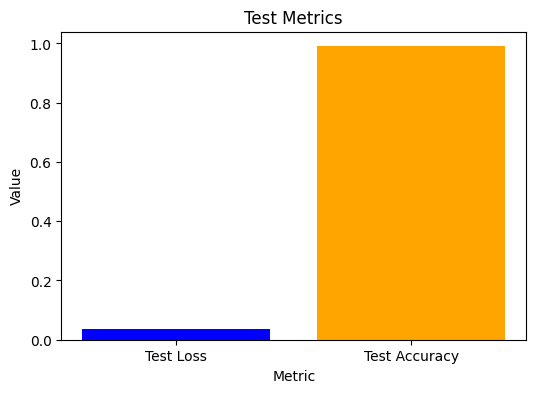

In [ ]:
import matplotlib.pyplot as plt

# Assume these are the metrics obtained after evaluation
test_loss = loss  # Example: test_loss = 0.123
test_accuracy = accuracy  # Example: test_accuracy = 0.987
# If `other_metrics` contains additional metrics like precision, recall, etc., you can extract them as needed
# For example, if `other_metrics` is a tuple or list, extract accordingly
# Example: precision, recall = other_metrics

# Print the metrics (already provided in your print statements)
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Additional Metrics: {other_metrics}")  # Adjust based on the actual content of `other_metrics`

# Plotting the Test Metrics
plt.figure(figsize=(6, 4))

# Plot test loss and accuracy as a bar plot
plt.bar(['Test Loss', 'Test Accuracy'], [test_loss, test_accuracy], color=['blue', 'orange'])
plt.xlabel('Metric')
plt.ylabel('Value')
plt.title('Test Metrics')
plt.show()

In [ ]:
# Predict on test data
predicted_masks = model.predict(test_ct_images)

threshold = 0.5  # Adjust threshold as needed
predicted_masks = (predicted_masks > threshold).astype(np.uint8)

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 477ms/step


NameError: name 'predicted_mask' is not defined

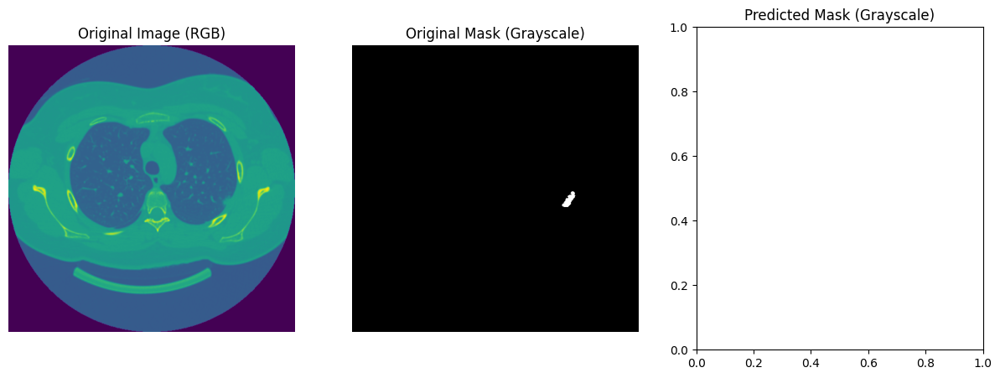

In [ ]:
# Ensure the original image is in uint8 format and scaled correctly
if test_ct_images[i].max() <= 1:
    test_ct_images[i] = (test_ct_images[i] * 255).astype(np.uint8)

# Check if the image is in BGR format and convert to RGB if necessary (for OpenCV loaded images)
if test_ct_images[i].shape[-1] == 3:  # Check if it is a 3-channel image
    test_ct_images[i] = cv2.cvtColor(test_ct_images[i], cv2.COLOR_BGR2RGB)

# Visualize the original image, true mask, and predicted mask
plt.figure(figsize=(15, 5))

# Show the original image
plt.subplot(1, 3, 1)
plt.title("Original Image (RGB)")
plt.imshow(test_ct_images[i])  # Display original image in correct color format
plt.axis('off')

# Show the true mask
plt.subplot(1, 3, 2)
plt.title("Original Mask (Grayscale)")
plt.imshow(test_mask[i], cmap='gray')  # Display true mask in grayscale
plt.axis('off')

# Show the predicted mask
plt.subplot(1, 3, 3)
plt.title("Predicted Mask (Grayscale)")
plt.imshow(predicted_mask, cmap='gray')  # Display predicted mask in grayscale
plt.axis('off')

plt.show()

In [ ]:
print(np.unique(predicted_masks))

[0 1]


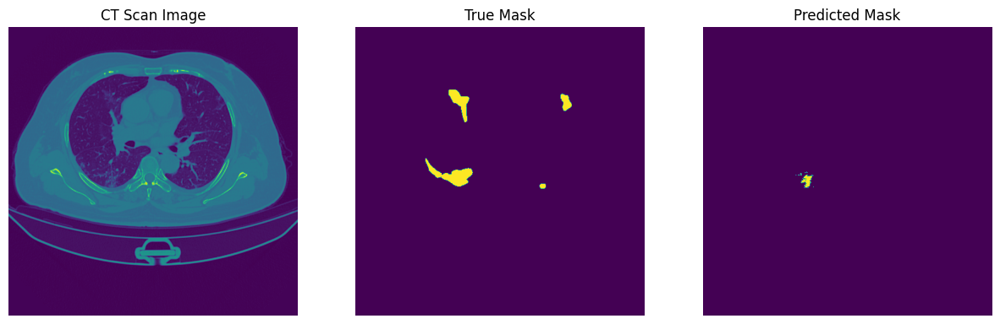

In [ ]:
import matplotlib.pyplot as plt

# Define colormaps
 # For predicted masks, you can use other colormaps like 'plasma'

# Define titles
ct_title = "CT Scan Image"
true_mask_title = "True Mask"
predicted_mask_title = "Predicted Mask"

# Visualize one result
i = 0  # Display the first image

plt.figure(figsize=(15, 5))  # Adjust the figure size if needed

plt.subplot(1, 3, 1)
plt.title(ct_title)
plt.imshow(test_ct_images[i])
plt.axis('off')  # Hide axes for better visualization

plt.subplot(1, 3, 2)
plt.title(true_mask_title)
plt.imshow(test_mask[i])
plt.axis('off')  # Hide axes for better visualization

plt.subplot(1, 3, 3)
plt.title(predicted_mask_title)
plt.imshow(predicted_masks[i])
plt.axis('off')  # Hide axes for better visualization

plt.show()

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 180ms/step
Predictions shape: (120, 512, 512, 1)
Min prediction value: 0.0
Max prediction value: 1.0
Binary Predictions shape: (120, 512, 512, 1)
Unique values in binary predictions: [0 1]


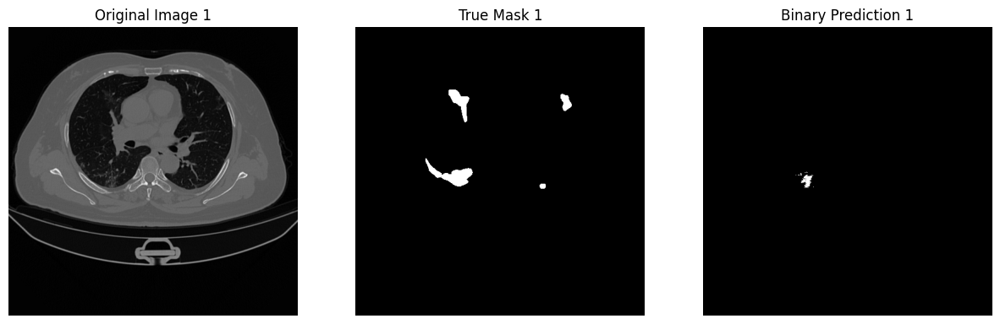

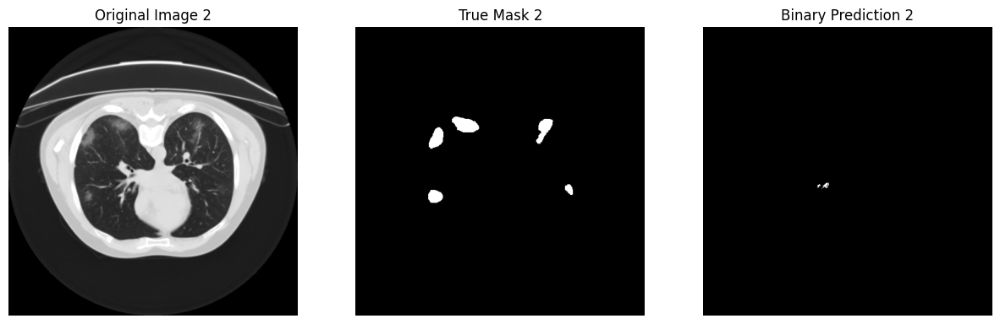

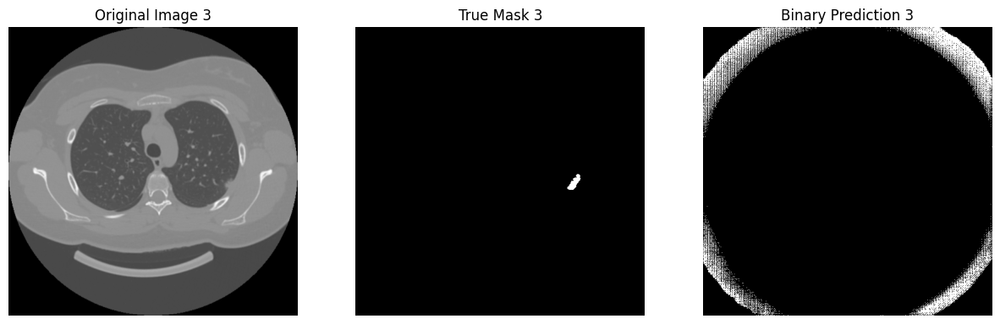

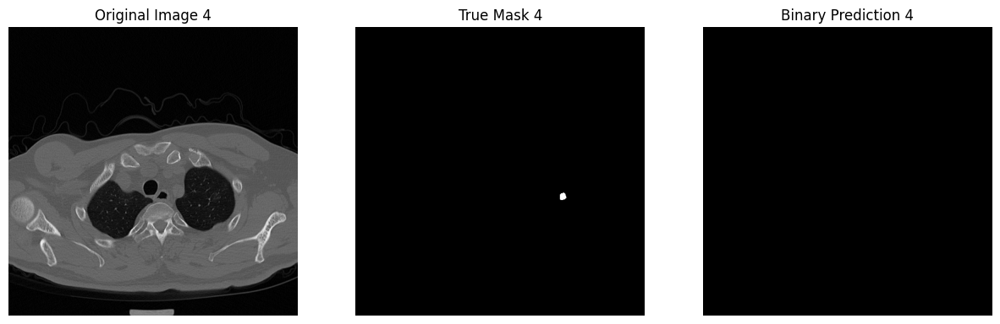

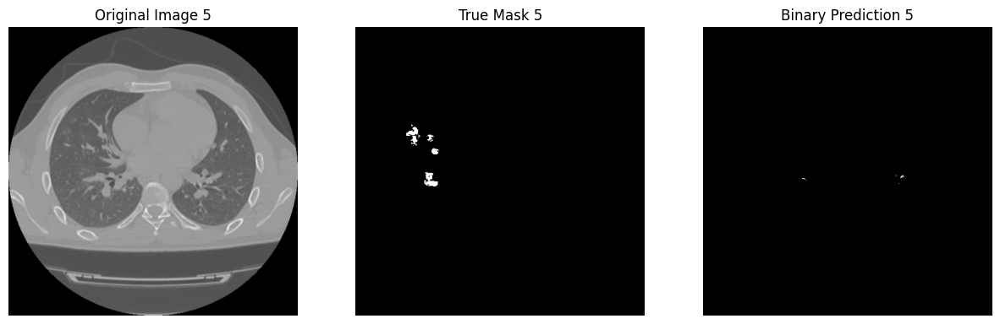

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Make predictions
predictions = model.predict(test_ct_images)

# Ensure the predictions are in a suitable range for thresholding
print("Predictions shape:", predictions.shape)
print("Min prediction value:", np.min(predictions))
print("Max prediction value:", np.max(predictions))

# Apply thresholding for binary prediction
threshold = 0.5  # You can adjust this if needed
predictions_binary = (predictions > threshold).astype(np.uint8)

# Check binary prediction values
print("Binary Predictions shape:", predictions_binary.shape)
print("Unique values in binary predictions:", np.unique(predictions_binary))

def plot_binary_predictions(images, true_masks, predictions_binary, num_images=5):
    """
    Plot the original image, true mask, and binary predicted mask.

    Parameters:
    - images: The input images (e.g., test_ct_images)
    - true_masks: The true masks (e.g., test_mask)
    - predictions_binary: The binary predicted masks
    - num_images: Number of images to plot
    """
    num_images = min(num_images, len(images))

    for i in range(num_images):
        # Select the image, true mask, and binary predicted mask at the specified index
        image = images[i]
        true_mask = true_masks[i]
        pred_binary_mask = predictions_binary[i]

        # Remove singleton dimensions if present
        image = np.squeeze(image)
        true_mask = np.squeeze(true_mask)
        pred_binary_mask = np.squeeze(pred_binary_mask)

        # Plot the results
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        # Original image
        axes[0].imshow(image, cmap='gray')  # Assuming single-channel CT images
        axes[0].set_title(f'Original Image {i+1}')
        axes[0].axis('off')

        # True mask
        axes[1].imshow(true_mask, cmap='gray')  # Assuming single-channel masks
        axes[1].set_title(f'True Mask {i+1}')
        axes[1].axis('off')

        # Binary predicted mask (after thresholding)
        axes[2].imshow(pred_binary_mask, cmap='gray')  # Binary mask after thresholding
        axes[2].set_title(f'Binary Prediction {i+1}')
        axes[2].axis('off')

        plt.show()

# Example usage: plot binary predictions for the first 5 images in the test set
plot_binary_predictions(test_ct_images, test_mask, predictions_binary, num_images=5)

# MÉTRICAS DE TREINAMENTO

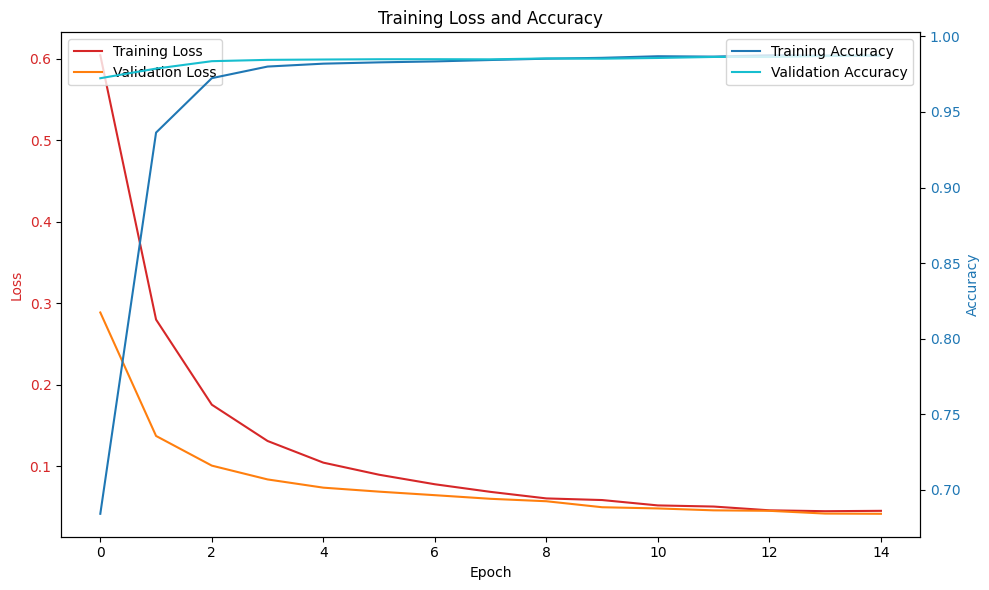

In [ ]:
# Extract metrics from history
history_dict = history.history

# Plot loss and accuracy on the same graph
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
color = 'tab:red'
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color=color)
ax1.plot(history_dict['loss'], color=color, label='Training Loss')
if 'val_loss' in history_dict:
    ax1.plot(history_dict['val_loss'], color='tab:orange', label='Validation Loss')
ax1.tick_params(axis='y', labelcolor=color)
ax1.legend(loc='upper left')

# Create a second y-axis for accuracy
ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Accuracy', color=color)
ax2.plot(history_dict['accuracy'], color=color, label='Training Accuracy')
if 'val_accuracy' in history_dict:
    ax2.plot(history_dict['val_accuracy'], color='tab:cyan', label='Validation Accuracy')
ax2.tick_params(axis='y', labelcolor=color)
ax2.legend(loc='upper right')

# Add titles and show plot
plt.title('Training Loss and Accuracy')
fig.tight_layout()
plt.show()

In [ ]:
import tensorflow as tf
import numpy as np

def dice_coefficient(y_true, y_pred, smooth=1e-6):
    """
    Compute the Dice coefficient between the ground truth and predictions.

    Args:
    y_true: Ground truth masks (numpy array or Tensor)
    y_pred: Predicted masks (numpy array or Tensor)
    smooth: Smoothing factor to avoid division by zero

    Returns:
    Dice coefficient score
    """
    # Convert tensors to numpy arrays if needed
    if isinstance(y_true, tf.Tensor):
        y_true = y_true.numpy()
    if isinstance(y_pred, tf.Tensor):
        y_pred = y_pred.numpy()

    # Flatten arrays
    y_true = y_true.flatten()
    y_pred = y_pred.flatten()

    # Calculate intersection and union
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred)

    # Compute Dice coefficient
    dice_score = (2. * intersection + smooth) / (union + smooth)
    return dice_score

# Example usage with a single prediction and ground truth
# Assume test_mask and predicted_masks are numpy arrays with the same shape
i = 0  # For the first image
dice_score = dice_coefficient(test_mask[i], predicted_masks[i])
print(f"Dice Coefficient for image {i}: {dice_score:.4f}")

Dice Coefficient for image 0: 0.1634


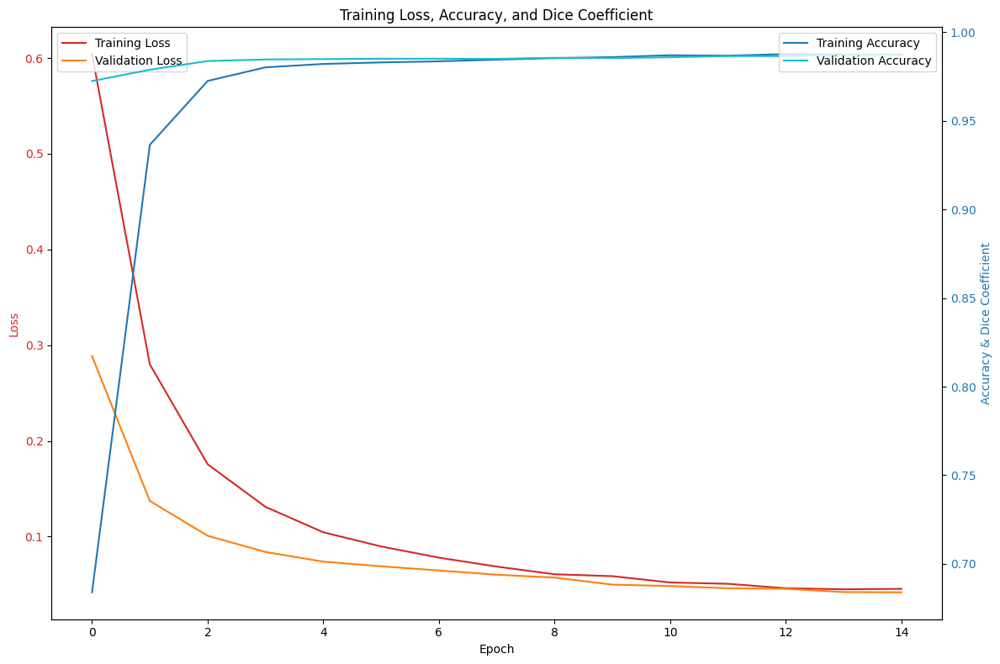

In [ ]:
import matplotlib.pyplot as plt

# Example history dictionary from training
history_dict = history.history

# Plot loss, accuracy, and Dice coefficient on the same graph
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot training loss
color = 'tab:red'
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color=color)
ax1.plot(history_dict['loss'], color=color, label='Training Loss')
if 'val_loss' in history_dict:
    ax1.plot(history_dict['val_loss'], color='tab:orange', label='Validation Loss')
ax1.tick_params(axis='y', labelcolor=color)
ax1.legend(loc='upper left')

# Create a second y-axis for accuracy and Dice coefficient
ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Accuracy & Dice Coefficient', color=color)
ax2.plot(history_dict['accuracy'], color=color, label='Training Accuracy')
if 'val_accuracy' in history_dict:
    ax2.plot(history_dict['val_accuracy'], color='tab:cyan', label='Validation Accuracy')
if 'dice_coefficient' in history_dict:
    ax2.plot(history_dict['dice_coefficient'], color='tab:green', linestyle='--', label='Training Dice Coefficient')
if 'val_dice_coefficient' in history_dict:
    ax2.plot(history_dict['val_dice_coefficient'], color='tab:olive', linestyle='--', label='Validation Dice Coefficient')
ax2.tick_params(axis='y', labelcolor=color)

# Add legends for the second y-axis
ax2.legend(loc='upper right')

# Add title and show plot
plt.title('Training Loss, Accuracy, and Dice Coefficient')
fig.tight_layout()
plt.show()

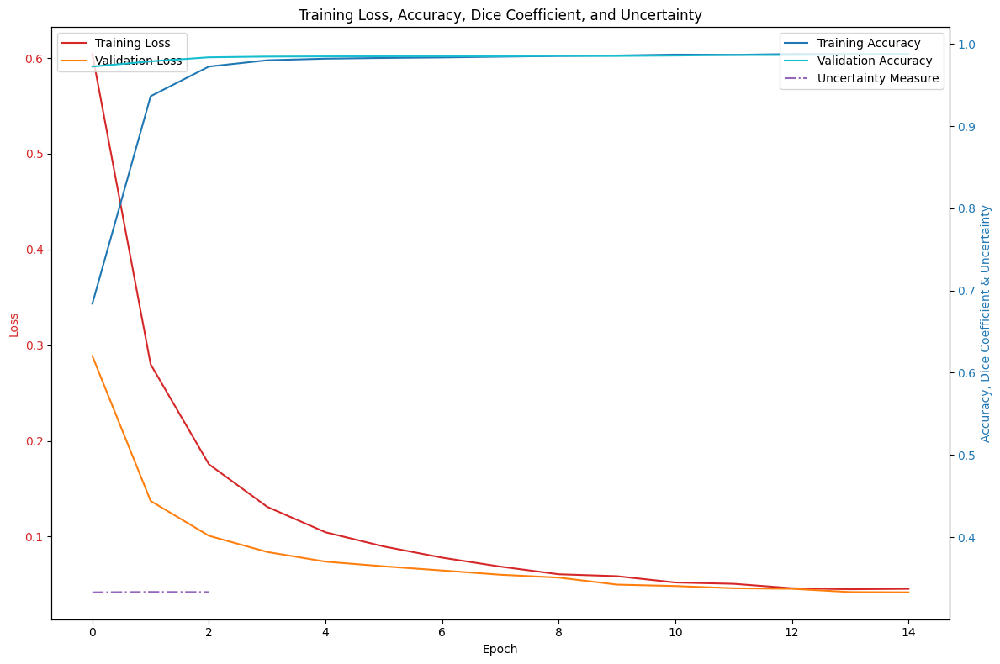

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Example function to calculate uncertainty measure (Mean Absolute Error)
def compute_uncertainty(true_masks, predicted_masks):
    # Assuming masks are binary or scaled appropriately
    return np.mean(np.abs(true_masks - predicted_masks), axis=(1, 2, 3))  # MAE per image

# Example data (replace with your actual test data)
test_ct_images = np.random.rand(3, 512, 512, 1)  # Example CT images
test_mask = np.random.rand(3, 512, 512, 1)  # Example ground truth masks
predicted_masks = np.random.rand(3, 512, 512, 1)  # Example predicted masks

# Compute the uncertainty measure
uncertainty = compute_uncertainty(test_mask, predicted_masks)

# Assuming you have the history object
history_dict = history.history

# Plot loss, accuracy, Dice coefficient, and uncertainty on the same graph
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot training loss
color = 'tab:red'
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color=color)
ax1.plot(history_dict['loss'], color=color, label='Training Loss')
if 'val_loss' in history_dict:
    ax1.plot(history_dict['val_loss'], color='tab:orange', label='Validation Loss')
ax1.tick_params(axis='y', labelcolor=color)
ax1.legend(loc='upper left')

# Create a second y-axis for accuracy, Dice coefficient, and uncertainty
ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Accuracy, Dice Coefficient & Uncertainty', color=color)
ax2.plot(history_dict['accuracy'], color=color, label='Training Accuracy')
if 'val_accuracy' in history_dict:
    ax2.plot(history_dict['val_accuracy'], color='tab:cyan', label='Validation Accuracy')
if 'dice_coefficient' in history_dict:
    ax2.plot(history_dict['dice_coefficient'], color='tab:green', linestyle='--', label='Training Dice Coefficient')
if 'val_dice_coefficient' in history_dict:
    ax2.plot(history_dict['val_dice_coefficient'], color='tab:olive', linestyle='--', label='Validation Dice Coefficient')

# Plot uncertainty measure (assuming you want to show it per epoch or as a summary)
if len(uncertainty) > 0:
    ax2.plot(range(len(uncertainty)), uncertainty, color='tab:purple', linestyle='-.', label='Uncertainty Measure')

ax2.tick_params(axis='y', labelcolor=color)

# Add legends for the second y-axis
ax2.legend(loc='upper right')

# Add title and show plot
plt.title('Training Loss, Accuracy, Dice Coefficient, and Uncertainty')
fig.tight_layout()
plt.show()

In [ ]:
# Predict on the test set
predicted_masks = model.predict(test_ct_images)

1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


In [ ]:
def compute_uncertainty_tf(true_masks, predicted_masks):
    # Verifique se as formas são iguais
    assert true_masks.shape == predicted_masks.shape, "Shapes of true masks and predicted masks must match"
    # Calcule a média do erro absoluto nas dimensões (1, 2, 3)
    uncertainty = tf.reduce_mean(tf.abs(true_masks - predicted_masks), axis=(1, 2, 3))
    return uncertainty

# Exemplo com tensores do TensorFlow
true_masks = tf.random.uniform((120, 512, 512, 1), minval=0, maxval=2, dtype=tf.float32)
predicted_masks = tf.random.uniform((120, 512, 512, 1), minval=0, maxval=2, dtype=tf.float32)

# Calcular a incerteza
uncertainties = compute_uncertainty_tf(true_masks, predicted_masks)

# Exibir a incerteza para cada imagem
print(uncertainties)

tf.Tensor(
[0.66701245 0.6685593  0.6669996  0.66674125 0.66645247 0.66748255
 0.66541183 0.6665799  0.6668969  0.66737694 0.66666913 0.6675695
 0.66616404 0.66695714 0.66642326 0.66631114 0.6665002  0.66817373
 0.665855   0.66663235 0.6671072  0.6683163  0.66721165 0.66513044
 0.66863924 0.6662468  0.6662719  0.66742843 0.66716325 0.66780216
 0.6684951  0.6662039  0.66652036 0.6667466  0.66793454 0.6658034
 0.6660735  0.6660609  0.6662068  0.66702163 0.6686259  0.666477
 0.66645527 0.66588795 0.6682117  0.6661614  0.66741526 0.6668379
 0.66705906 0.66575456 0.66651326 0.66512805 0.66644764 0.6665637
 0.66629195 0.66843355 0.6680089  0.6677751  0.66676    0.6670109
 0.66664135 0.6664265  0.6661945  0.667469   0.6661892  0.66624165
 0.66740316 0.66633224 0.6669451  0.6671695  0.66781765 0.66756153
 0.6673058  0.66730815 0.66651213 0.6667189  0.66608083 0.66507685
 0.6671485  0.6670548  0.66590166 0.66488314 0.6658344  0.6676628
 0.6676491  0.6675497  0.66682184 0.6682402  0.6671151  0.6

In [ ]:
uncertainties

<tf.Tensor: shape=(120,), dtype=float32, numpy=
array([0.66701245, 0.6685593 , 0.6669996 , 0.66674125, 0.66645247,
       0.66748255, 0.66541183, 0.6665799 , 0.6668969 , 0.66737694,
       0.66666913, 0.6675695 , 0.66616404, 0.66695714, 0.66642326,
       0.66631114, 0.6665002 , 0.66817373, 0.665855  , 0.66663235,
       0.6671072 , 0.6683163 , 0.66721165, 0.66513044, 0.66863924,
       0.6662468 , 0.6662719 , 0.66742843, 0.66716325, 0.66780216,
       0.6684951 , 0.6662039 , 0.66652036, 0.6667466 , 0.66793454,
       0.6658034 , 0.6660735 , 0.6660609 , 0.6662068 , 0.66702163,
       0.6686259 , 0.666477  , 0.66645527, 0.66588795, 0.6682117 ,
       0.6661614 , 0.66741526, 0.6668379 , 0.66705906, 0.66575456,
       0.66651326, 0.66512805, 0.66644764, 0.6665637 , 0.66629195,
       0.66843355, 0.6680089 , 0.6677751 , 0.66676   , 0.6670109 ,
       0.66664135, 0.6664265 , 0.6661945 , 0.667469  , 0.6661892 ,
       0.66624165, 0.66740316, 0.66633224, 0.6669451 , 0.6671695 ,
       0.66781

In [ ]:
import numpy as np
import tensorflow as tf

def predict_with_uncertainty(model, X, n_iter=100):
    """
    Predict with uncertainty using MC Dropout.

    Parameters:
    - model: The Keras model with dropout layers
    - X: Input data
    - n_iter: Number of forward passes to estimate uncertainty

    Returns:
    - mean_predictions: Mean prediction across all iterations
    - uncertainty: Uncertainty estimate (standard deviation)
    """
    # Create an empty list to store predictions
    predictions = np.zeros((n_iter,) + X.shape)

    # Run predictions with dropout enabled
    for i in range(n_iter):
        predictions[i] = model(X, training=True).numpy()

    # Compute mean and uncertainty (standard deviation) across iterations
    mean_predictions = predictions.mean(axis=0)
    uncertainty = predictions.std(axis=0)

    return mean_predictions, uncertainty

# Example usage
# Ensure that `model` is your trained model
n_iter = 100  # Number of Monte Carlo samples
mean_predictions, uncertainty = predict_with_uncertainty(model, test_ct_images, n_iter=n_iter)

print("Mean Predictions Shape:", mean_predictions.shape)
print("Uncertainty Shape:", uncertainty.shape)

Mean Predictions Shape: (3, 512, 512, 1)
Uncertainty Shape: (3, 512, 512, 1)


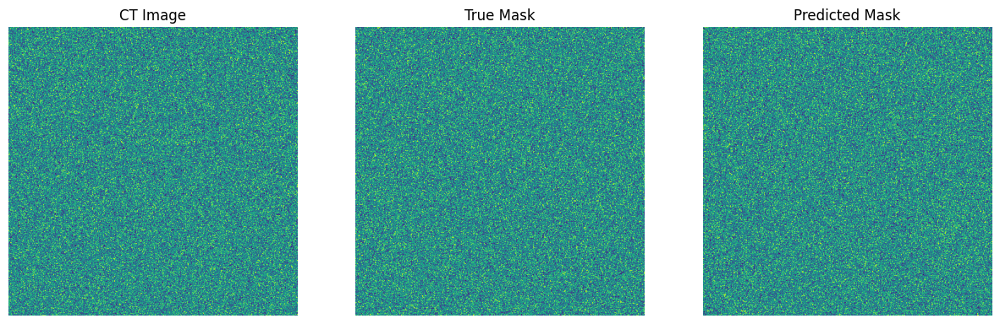

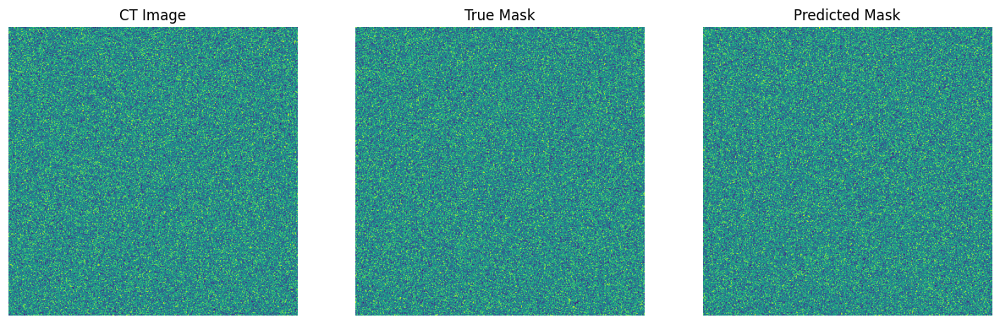

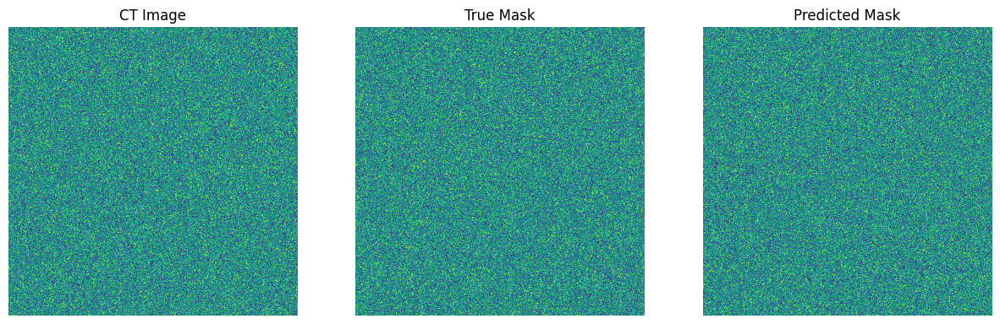

In [ ]:
import matplotlib.pyplot as plt

# Visualize a few examples
for i in range(3):  # Display the first 3 examples
    plt.figure(figsize=(15, 15))

    plt.subplot(1, 3, 1)
    plt.title("CT Image")
    plt.imshow(test_ct_images[i])
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("True Mask")
    plt.imshow(test_mask[i])
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title("Predicted Mask")
    plt.imshow(predicted_masks[i])
    plt.axis('off')

    plt.show()

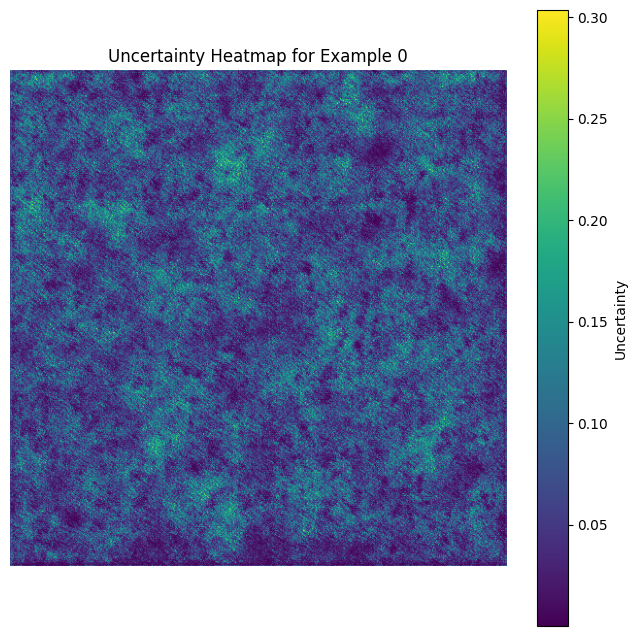

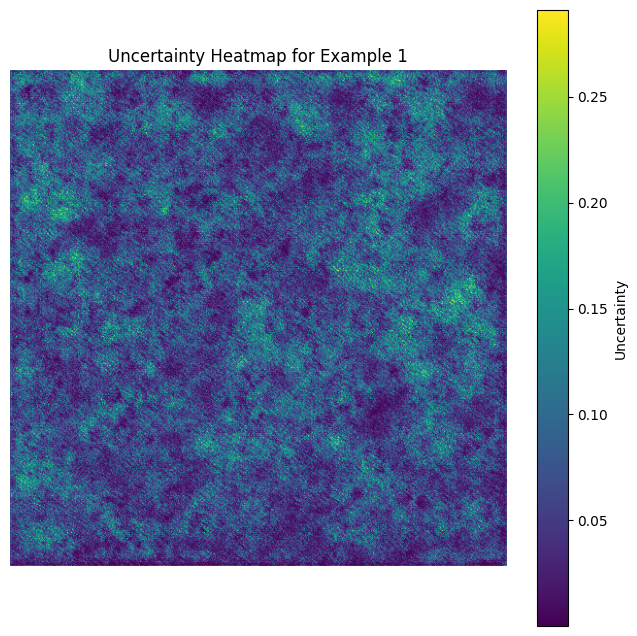

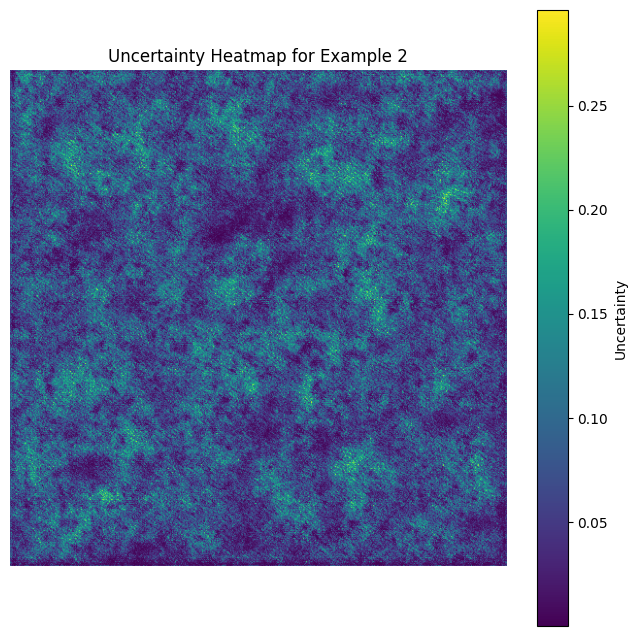

In [ ]:
import matplotlib.pyplot as plt

def plot_uncertainty_heatmap(uncertainty, num_examples=3):
    for i in range(num_examples):
        plt.figure(figsize=(8, 8))
        plt.imshow(uncertainty[i], cmap='viridis')
        plt.colorbar(label='Uncertainty')
        plt.title(f'Uncertainty Heatmap for Example {i}')
        plt.axis('off')
        plt.show()

# Example usage
plot_uncertainty_heatmap(uncertainty)

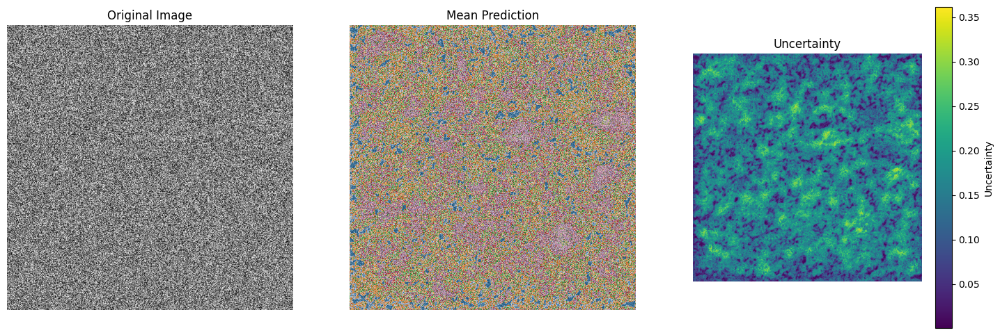

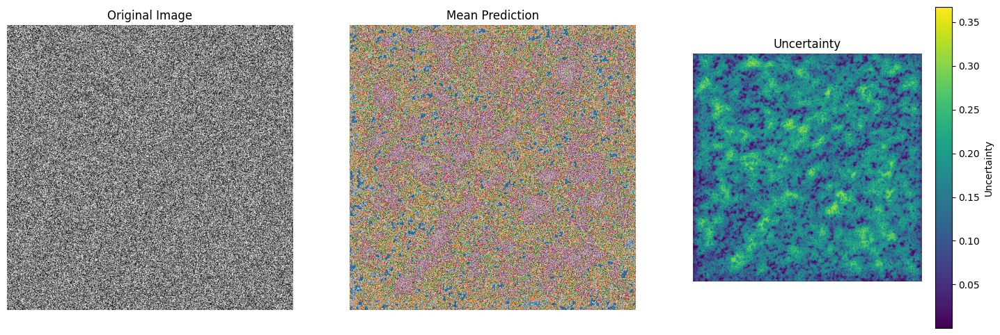

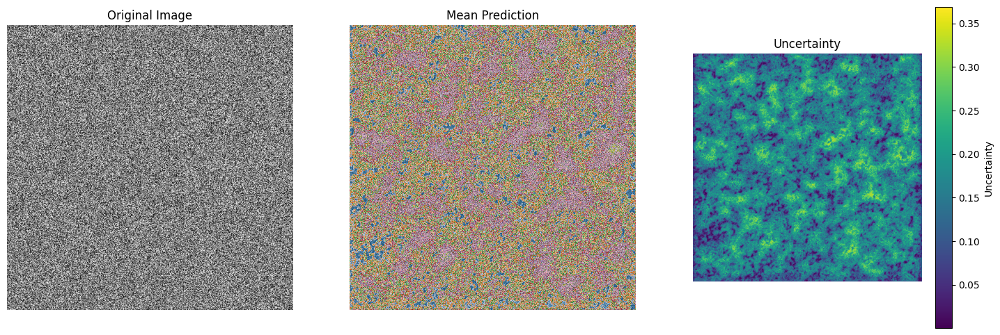

In [ ]:
import matplotlib.pyplot as plt

def plot_with_annotations(original_images, mean_predictions, uncertainties, num_examples=3):
    for i in range(num_examples):
        fig, ax = plt.subplots(1, 3, figsize=(18, 6))

        # Original Image
        ax[0].imshow(original_images[i], cmap='gray')
        ax[0].set_title("Original Image")
        ax[0].axis('off')

        # Mean Prediction with Overlay
        ax[1].imshow(original_images[i], cmap='gray')
        ax[1].imshow(mean_predictions[i], cmap='tab20', alpha=0.6)
        ax[1].set_title("Mean Prediction")
        ax[1].axis('off')

        # Uncertainty with Annotations
        im = ax[2].imshow(uncertainties[i], cmap='viridis')
        ax[2].set_title("Uncertainty")
        ax[2].axis('off')
        plt.colorbar(im, ax=ax[2], orientation='vertical', label='Uncertainty')

        plt.show()

# Example usage
plot_with_annotations(test_ct_images, mean_predictions, uncertainty)

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model



In [ ]:
def preprocess_image(image_path):
    """Carrega e normaliza uma imagem."""
    image = tf.keras.utils.load_img(image_path, color_mode="grayscale", target_size=(256, 256))
    image = tf.keras.utils.img_to_array(image) / 255.0
    image = np.expand_dims(image, axis=0)  # Adicionar batch dimension
    return image

def classify_lung(image, model, threshold=0.1):
    """
    Classifica se o pulmão tem lesões significativas.
    - `image`: imagem pré-processada.
    - `model`: modelo de segmentação treinado.
    - `threshold`: proporção mínima de lesões para classificar como 'com lesão'.
    """
    prediction = model.predict(image)[0, :, :, 0]  # Predição da máscara
    lesion_area = np.sum(prediction > 0.5)  # Contar pixels acima do limiar
    total_area = np.prod(prediction.shape)
    lesion_ratio = lesion_area / total_area

    return lesion_ratio > threshold, lesion_ratio



In [ ]:
#model = load_model("/content/your_trained_model.h5", compile=False)

In [ ]:
model.save("your_trained_model.h5")

In [ ]:
model.save("my_model.keras")

In [ ]:
model = tf.keras.models.load_model("my_model.keras")

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'loss_scale_optimizer', because it has 56 variables whereas the saved optimizer has 106 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))
/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 52 variables whereas the saved optimizer has 102 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [ ]:
model.save("my_model.h5")

In [ ]:
# Definir o caminho completo para uma imagem específica dentro do diretório
image_path = os.path.join(dataset_dir, 'image_1.png')  # ou qualquer outro nome de arquivo



if has_lesion:
    print(f"Lesão detectada! Proporção: {lesion_ratio:.2%}")
else:
    print("Pulmão sem lesões significativas.")

FileNotFoundError: [Errno 2] No such file or directory: './covid19-ct-scan-lesion-segmentation-dataset/frames/image_1.png'

In [ ]:
# Definir o caminho completo para uma imagem específica dentro do diretório
image_path = os.path.join(dataset_dir, 'image_1.png')  # ou qualquer outro nome de arquivo


In [ ]:
# Listar todos os arquivos de imagem no diretório
image_files = [f for f in os.listdir(dataset_dir) if f.endswith('.png')]  # ou '.jpg', dependendo do formato


In [ ]:
from keras.preprocessing.image import load_img, img_to_array
import os

dataset_dir = './covid19-ct-scan-lesion-segmentation-dataset/frames'
image_files = [f for f in os.listdir(dataset_dir) if f.endswith('.png')]  # ou '.jpg'

def preprocess_image(image_path):
    # Carregar a imagem, forçando para escala de cinza
    image = load_img(image_path, color_mode='grayscale', target_size=(512, 512))

    # Converter para array NumPy e normalizar
    image_array = img_to_array(image) / 255.0

    # Adicionar a dimensão de canal
    image_array = np.expand_dims(image_array, axis=-1)

    return image_array


In [ ]:
### PRIMEIRAS 150


# Inicializar o contador
lesions_detected_count = 0

# Selecionar apenas as primeiras 150 imagens
image_files = image_files[:150]

# Processar as imagens
for image_file in image_files:
    image_path = os.path.join(dataset_dir, image_file)
    image = preprocess_image(image_path)

#######################
    image = np.expand_dims(image, axis=0)  # Adiciona a dimensão de batch

    has_lesion, lesion_ratio = classify_lung(image, model)

    # Verificar se a lesão foi detectada
    if has_lesion:
        lesions_detected_count += 1  # Incrementa o contador se a lesão for detectada

    print(f'Imagem: {image_file}, Lesão detectada: {has_lesion}, Proporção da lesão: {lesion_ratio}')


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Imagem: Morozov_study_0264_23.png, Lesão detectada: False, Proporção da lesão: 0.00305938720703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Imagem: Jun_coronacases_case6_83.png, Lesão detectada: False, Proporção da lesão: 0.001819610595703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Imagem: Jun_radiopaedia_10_85902_3_case12_77.png, Lesão detectada: True, Proporção da lesão: 0.4769172668457031
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Imagem: Morozov_study_0261_16.png, Lesão detectada: False, Proporção da lesão: 0.001148223876953125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Jun_coronacases_case1_145.png, Lesão detectada: False, Proporção da lesão: 0.00962066650390625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Jun_coronacases_case9_190.png, Lesão detectada: False, Proporção da lesão: 0.010005950927734375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Imagem: Jun_coronacases_case3_49.png, Lesão detectada: False, Proporção da lesão: 2.6702880859375e-05
1/1 ━━━━━━━

In [ ]:
# Exibir o total de imagens com lesão detectada
print(f'Total de imagens com lesão detectada: {lesions_detected_count}')


Total de imagens com lesão detectada: 29


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Morozov_study_0264_23.png, Lesão detectada: False, Proporção da lesão: 0.00305938720703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Jun_coronacases_case6_83.png, Lesão detectada: False, Proporção da lesão: 0.001819610595703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


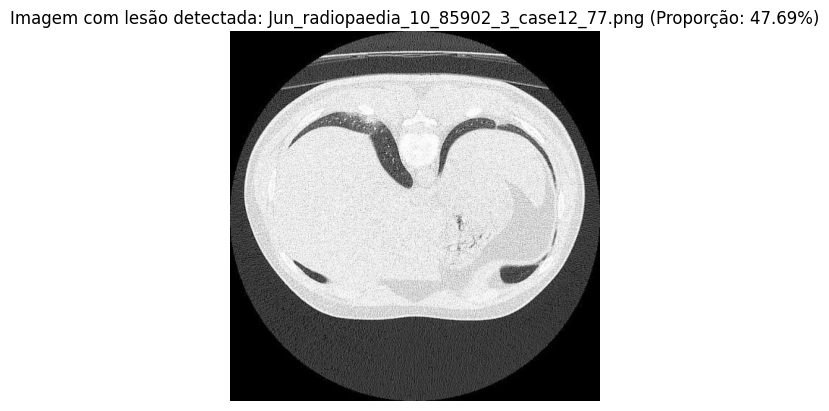

Imagem: Jun_radiopaedia_10_85902_3_case12_77.png, Lesão detectada: True, Proporção da lesão: 0.4769172668457031
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Imagem: Morozov_study_0261_16.png, Lesão detectada: False, Proporção da lesão: 0.001148223876953125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Imagem: Jun_coronacases_case1_145.png, Lesão detectada: False, Proporção da lesão: 0.00962066650390625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem: Jun_coronacases_case9_190.png, Lesão detectada: False, Proporção da lesão: 0.010005950927734375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Imagem: Jun_coronacases_case3_49.png, Lesão detectada: False, Proporção da lesão: 2.6702880859375e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Imagem: Jun_coronacases_case1_128.png, Lesão detectada: False, Proporção da lesão: 0.00461578369140625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Imagem: Jun_coronacases_case7_162.png, Lesão detectada: False, Proporção da lesão: 0.00652313232421875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


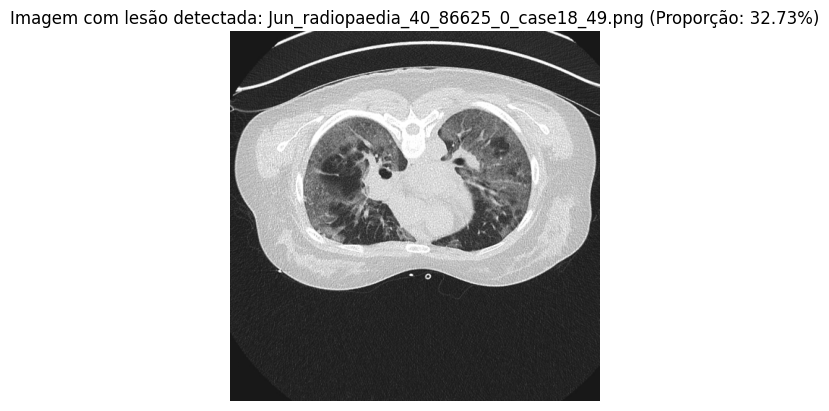

Imagem: Jun_radiopaedia_40_86625_0_case18_49.png, Lesão detectada: True, Proporção da lesão: 0.32727813720703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Imagem: Jun_coronacases_case4_144.png, Lesão detectada: False, Proporção da lesão: 0.015522003173828125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Imagem: Jun_coronacases_case5_144.png, Lesão detectada: False, Proporção da lesão: 0.010189056396484375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Imagem: Jun_coronacases_case8_51.png, Lesão detectada: False, Proporção da lesão: 0.005035400390625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


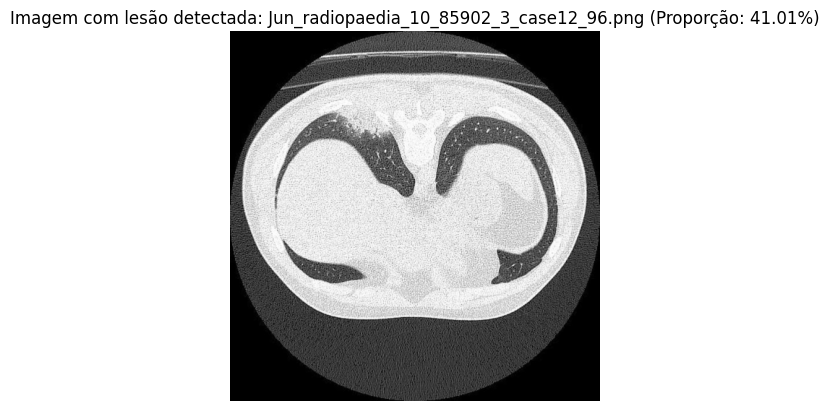

Imagem: Jun_radiopaedia_10_85902_3_case12_96.png, Lesão detectada: True, Proporção da lesão: 0.4100761413574219
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


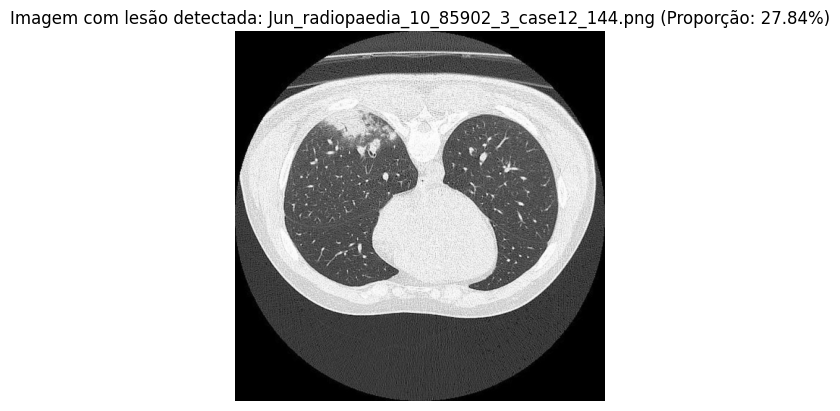

Imagem: Jun_radiopaedia_10_85902_3_case12_144.png, Lesão detectada: True, Proporção da lesão: 0.2784271240234375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Imagem: Morozov_study_0264_18.png, Lesão detectada: False, Proporção da lesão: 0.003147125244140625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem: Jun_coronacases_case10_109.png, Lesão detectada: False, Proporção da lesão: 0.0019683837890625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Imagem: Morozov_study_0273_20.png, Lesão detectada: False, Proporção da lesão: 0.004974365234375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Imagem: Jun_coronacases_case3_119.png, Lesão detectada: False, Proporção da lesão: 0.008056640625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Imagem: Jun_coronacases_case2_58.png, Lesão detectada: False, Proporção da lesão: 0.00119781494140625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Imagem: Jun_coronacases_case1_153.png, Lesão detectada: False, Proporção da lesão: 0.009098052978515625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Imagem: Jun_coron

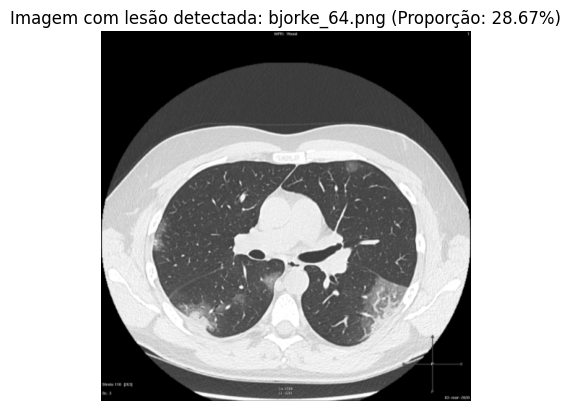

Imagem: bjorke_64.png, Lesão detectada: True, Proporção da lesão: 0.28665924072265625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Imagem: Jun_coronacases_case8_62.png, Lesão detectada: False, Proporção da lesão: 0.004055023193359375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Imagem: Morozov_study_0281_33.png, Lesão detectada: False, Proporção da lesão: 0.0070037841796875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Jun_coronacases_case8_152.png, Lesão detectada: False, Proporção da lesão: 0.0150146484375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Imagem: Jun_coronacases_case5_82.png, Lesão detectada: False, Proporção da lesão: 0.007968902587890625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Jun_coronacases_case3_75.png, Lesão detectada: False, Proporção da lesão: 0.00347137451171875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


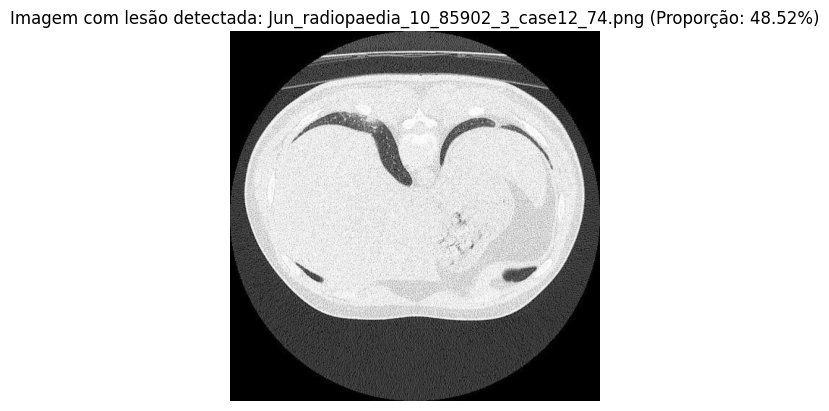

Imagem: Jun_radiopaedia_10_85902_3_case12_74.png, Lesão detectada: True, Proporção da lesão: 0.4851799011230469
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Imagem: Jun_coronacases_case10_214.png, Lesão detectada: False, Proporção da lesão: 0.002166748046875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Imagem: Jun_coronacases_case8_65.png, Lesão detectada: False, Proporção da lesão: 0.000156402587890625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


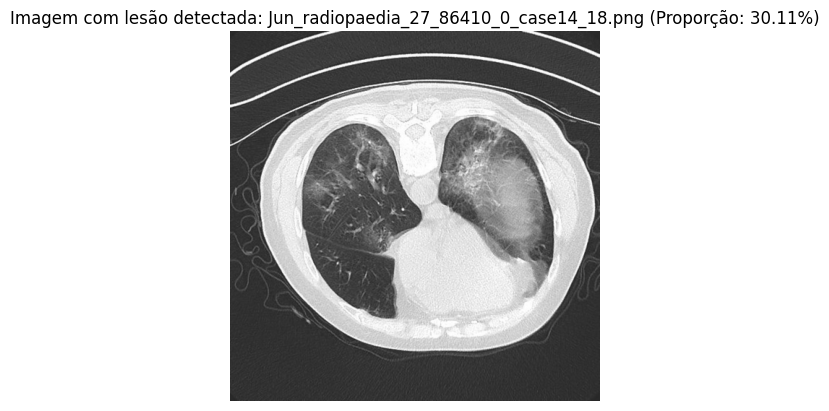

Imagem: Jun_radiopaedia_27_86410_0_case14_18.png, Lesão detectada: True, Proporção da lesão: 0.30109405517578125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Jun_coronacases_case5_179.png, Lesão detectada: False, Proporção da lesão: 0.015247344970703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Jun_coronacases_case1_115.png, Lesão detectada: False, Proporção da lesão: 0.00365447998046875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


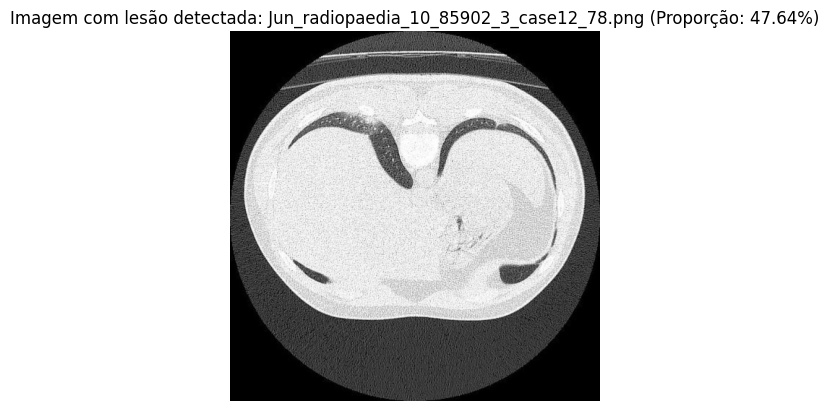

Imagem: Jun_radiopaedia_10_85902_3_case12_78.png, Lesão detectada: True, Proporção da lesão: 0.4763946533203125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Imagem: Jun_coronacases_case3_141.png, Lesão detectada: False, Proporção da lesão: 0.005565643310546875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Imagem: Jun_coronacases_case2_49.png, Lesão detectada: False, Proporção da lesão: 0.000827789306640625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Jun_coronacases_case8_223.png, Lesão detectada: False, Proporção da lesão: 4.57763671875e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


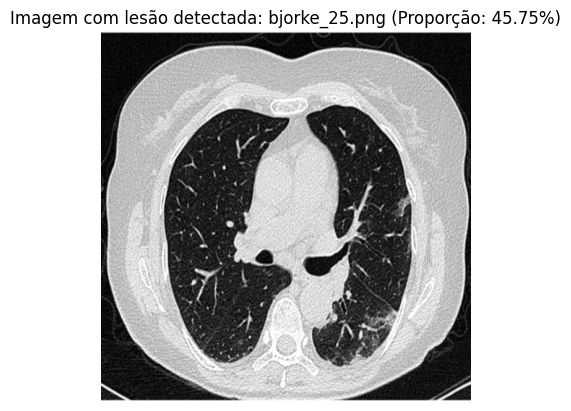

Imagem: bjorke_25.png, Lesão detectada: True, Proporção da lesão: 0.45746612548828125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Imagem: Jun_coronacases_case9_184.png, Lesão detectada: False, Proporção da lesão: 0.009593963623046875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Imagem: Morozov_study_0257_20.png, Lesão detectada: False, Proporção da lesão: 0.00476837158203125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Morozov_study_0275_21.png, Lesão detectada: False, Proporção da lesão: 0.00433349609375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Imagem: Jun_coronacases_case9_89.png, Lesão detectada: False, Proporção da lesão: 0.004253387451171875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Jun_coronacases_case4_85.png, Lesão detectada: False, Proporção da lesão: 0.010631561279296875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Imagem: Morozov_study_0276_32.png, Lesão detectada: False, Proporção da lesão: 2.288818359375e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Imagem: Morozov_study_0275_22.png, Lesão dete

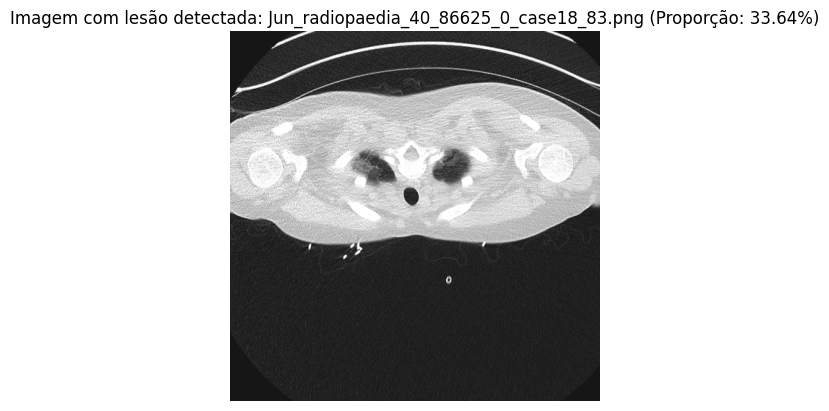

Imagem: Jun_radiopaedia_40_86625_0_case18_83.png, Lesão detectada: True, Proporção da lesão: 0.33642578125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Morozov_study_0290_8.png, Lesão detectada: False, Proporção da lesão: 0.00213623046875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Morozov_study_0299_9.png, Lesão detectada: False, Proporção da lesão: 3.4332275390625e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


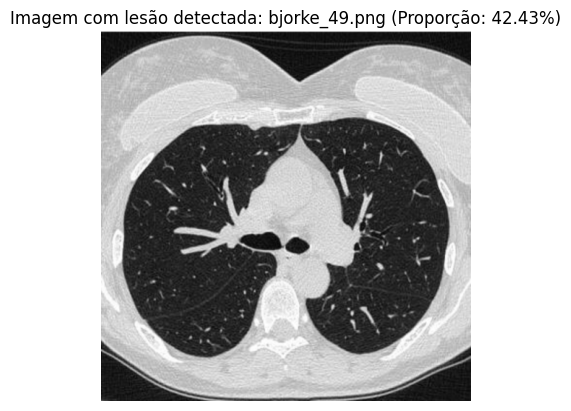

Imagem: bjorke_49.png, Lesão detectada: True, Proporção da lesão: 0.4242973327636719
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Imagem: Jun_coronacases_case1_220.png, Lesão detectada: False, Proporção da lesão: 0.00445556640625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Imagem: Jun_coronacases_case6_97.png, Lesão detectada: False, Proporção da lesão: 0.003696441650390625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


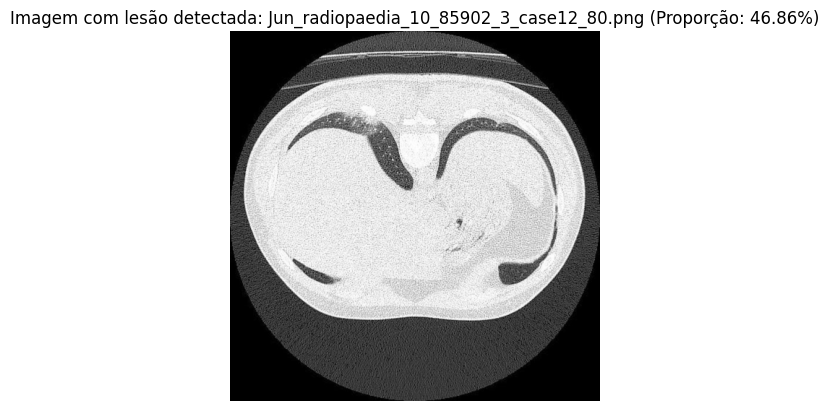

Imagem: Jun_radiopaedia_10_85902_3_case12_80.png, Lesão detectada: True, Proporção da lesão: 0.4685554504394531
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Imagem: Morozov_study_0294_20.png, Lesão detectada: False, Proporção da lesão: 0.002834320068359375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Morozov_study_0265_17.png, Lesão detectada: False, Proporção da lesão: 0.00079345703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Imagem: Morozov_study_0291_25.png, Lesão detectada: False, Proporção da lesão: 0.00119781494140625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Imagem: Jun_coronacases_case9_175.png, Lesão detectada: False, Proporção da lesão: 0.01012420654296875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Imagem: Jun_coronacases_case6_78.png, Lesão detectada: False, Proporção da lesão: 0.0027008056640625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


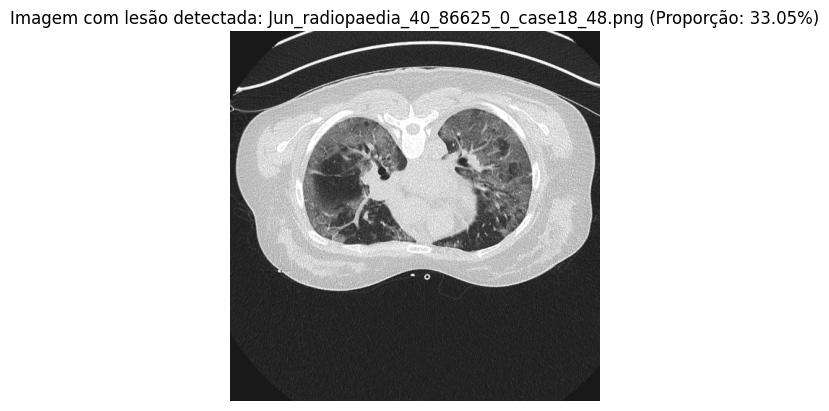

Imagem: Jun_radiopaedia_40_86625_0_case18_48.png, Lesão detectada: True, Proporção da lesão: 0.33052825927734375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Imagem: Jun_coronacases_case4_110.png, Lesão detectada: False, Proporção da lesão: 0.006473541259765625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


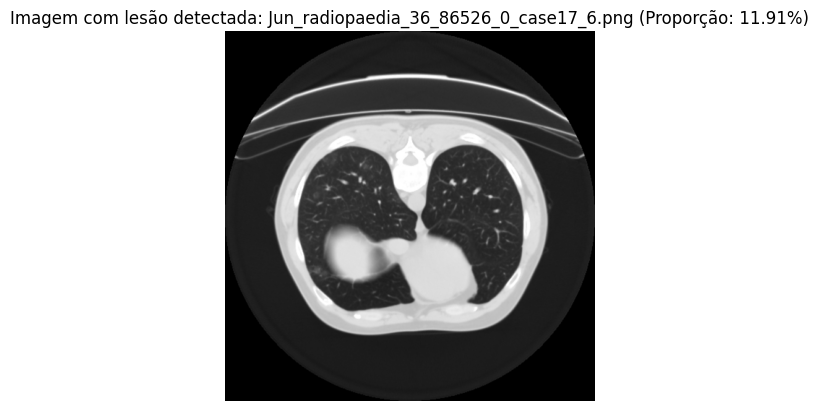

Imagem: Jun_radiopaedia_36_86526_0_case17_6.png, Lesão detectada: True, Proporção da lesão: 0.119110107421875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Imagem: Morozov_study_0282_18.png, Lesão detectada: False, Proporção da lesão: 0.004207611083984375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Imagem: Jun_coronacases_case3_120.png, Lesão detectada: False, Proporção da lesão: 0.007740020751953125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Imagem: Morozov_study_0259_18.png, Lesão detectada: False, Proporção da lesão: 0.00734710693359375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Imagem: Jun_coronacases_case1_82.png, Lesão detectada: False, Proporção da lesão: 0.0011138916015625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Imagem: Jun_coronacases_case6_74.png, Lesão detectada: False, Proporção da lesão: 0.00191497802734375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Imagem: Jun_coronacases_case2_168.png, Lesão detectada: False, Proporção da lesão: 0.0027008056640625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Imagem: Jun_coro

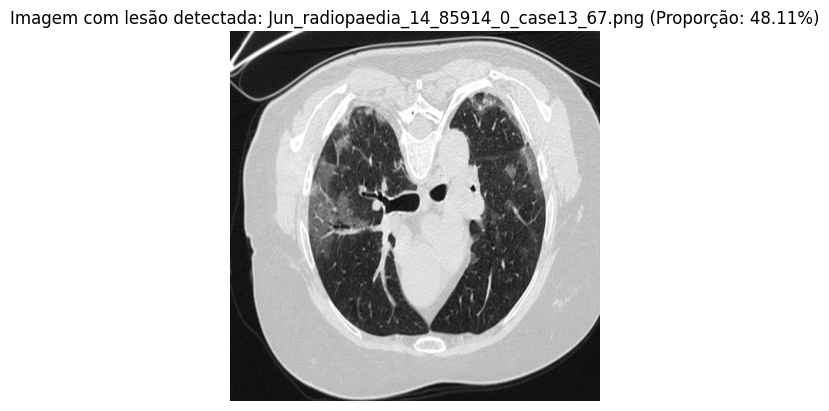

Imagem: Jun_radiopaedia_14_85914_0_case13_67.png, Lesão detectada: True, Proporção da lesão: 0.4810752868652344
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


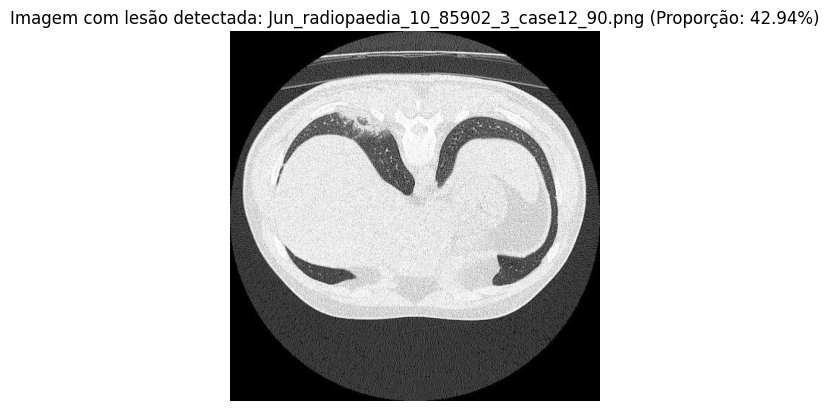

Imagem: Jun_radiopaedia_10_85902_3_case12_90.png, Lesão detectada: True, Proporção da lesão: 0.4293670654296875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Imagem: Morozov_study_0255_29.png, Lesão detectada: False, Proporção da lesão: 9.918212890625e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Imagem: Morozov_study_0258_22.png, Lesão detectada: False, Proporção da lesão: 0.00244903564453125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


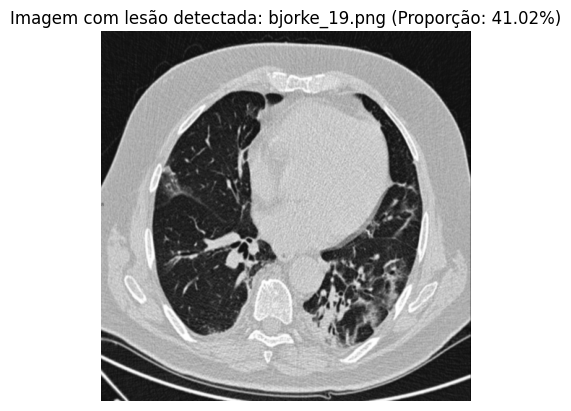

Imagem: bjorke_19.png, Lesão detectada: True, Proporção da lesão: 0.4102020263671875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Imagem: Morozov_study_0302_27.png, Lesão detectada: False, Proporção da lesão: 0.003795623779296875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Imagem: Jun_coronacases_case8_235.png, Lesão detectada: False, Proporção da lesão: 8.0108642578125e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Imagem: Jun_coronacases_case10_112.png, Lesão detectada: False, Proporção da lesão: 0.00261688232421875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Imagem: Jun_coronacases_case4_162.png, Lesão detectada: False, Proporção da lesão: 0.012607574462890625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Imagem: Morozov_study_0269_16.png, Lesão detectada: False, Proporção da lesão: 0.0003509521484375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Imagem: Jun_coronacases_case7_141.png, Lesão detectada: False, Proporção da lesão: 0.008777618408203125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


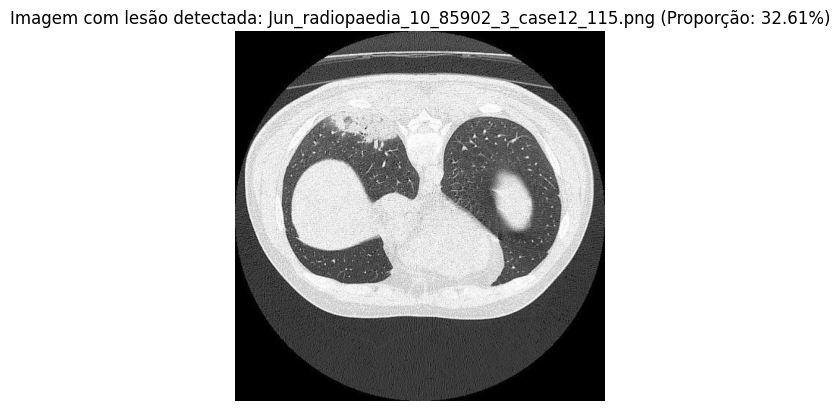

Imagem: Jun_radiopaedia_10_85902_3_case12_115.png, Lesão detectada: True, Proporção da lesão: 0.3261070251464844
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Imagem: Jun_coronacases_case9_99.png, Lesão detectada: False, Proporção da lesão: 0.0117340087890625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Imagem: Morozov_study_0303_22.png, Lesão detectada: False, Proporção da lesão: 0.00037384033203125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


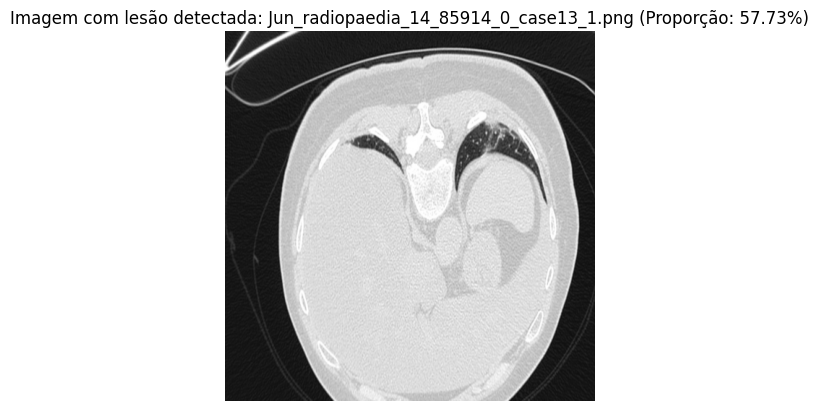

Imagem: Jun_radiopaedia_14_85914_0_case13_1.png, Lesão detectada: True, Proporção da lesão: 0.5773239135742188
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Imagem: Jun_coronacases_case2_152.png, Lesão detectada: False, Proporção da lesão: 0.002674102783203125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Imagem: Jun_coronacases_case3_159.png, Lesão detectada: False, Proporção da lesão: 7.62939453125e-06
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Imagem: Jun_coronacases_case8_241.png, Lesão detectada: False, Proporção da lesão: 0.0037841796875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Imagem: Jun_coronacases_case4_74.png, Lesão detectada: False, Proporção da lesão: 0.006511688232421875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Imagem: Morozov_study_0264_11.png, Lesão detectada: False, Proporção da lesão: 0.001926422119140625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Imagem: Morozov_study_0266_12.png, Lesão detectada: False, Proporção da lesão: 3.814697265625e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Imagem: Morozov_st

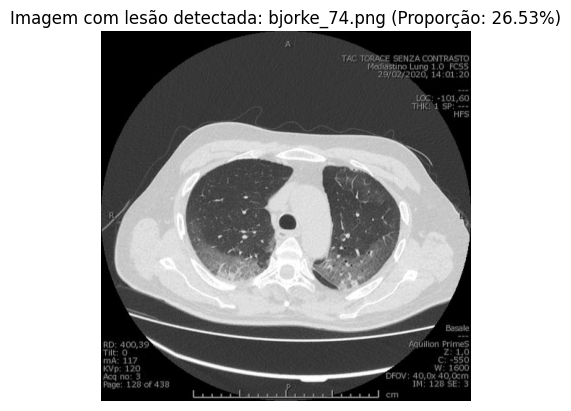

Imagem: bjorke_74.png, Lesão detectada: True, Proporção da lesão: 0.2653007507324219
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Imagem: Jun_coronacases_case1_154.png, Lesão detectada: False, Proporção da lesão: 0.010868072509765625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Imagem: Jun_coronacases_case10_264.png, Lesão detectada: False, Proporção da lesão: 0.008243560791015625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Imagem: Jun_coronacases_case1_175.png, Lesão detectada: False, Proporção da lesão: 0.00859832763671875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Imagem: Jun_coronacases_case9_120.png, Lesão detectada: False, Proporção da lesão: 0.006114959716796875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


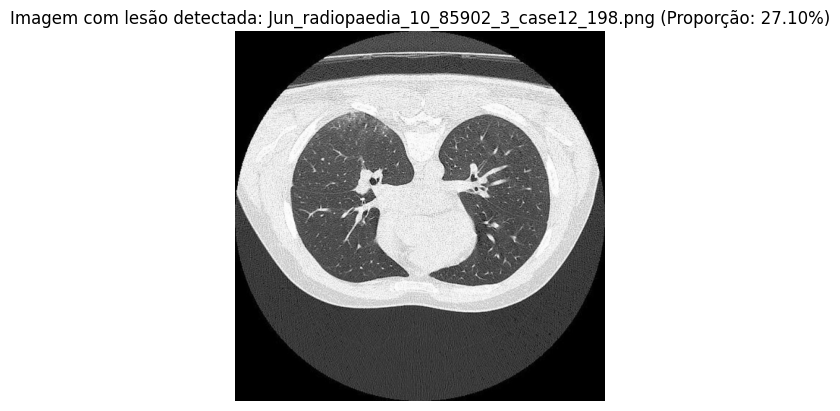

Imagem: Jun_radiopaedia_10_85902_3_case12_198.png, Lesão detectada: True, Proporção da lesão: 0.2709617614746094
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Imagem: Jun_coronacases_case8_116.png, Lesão detectada: False, Proporção da lesão: 0.008380889892578125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Imagem: Morozov_study_0276_19.png, Lesão detectada: False, Proporção da lesão: 0.00208282470703125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Imagem: Jun_coronacases_case8_88.png, Lesão detectada: False, Proporção da lesão: 0.006526947021484375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


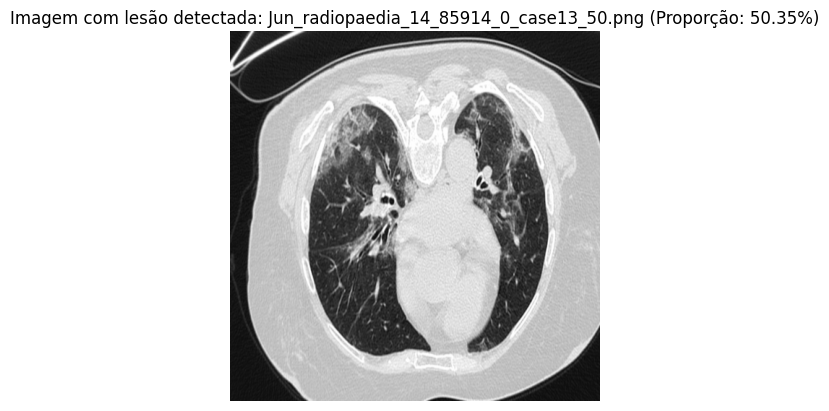

Imagem: Jun_radiopaedia_14_85914_0_case13_50.png, Lesão detectada: True, Proporção da lesão: 0.5035362243652344
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Imagem: Jun_coronacases_case2_76.png, Lesão detectada: False, Proporção da lesão: 0.00205230712890625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Imagem: Morozov_study_0258_24.png, Lesão detectada: False, Proporção da lesão: 0.0023956298828125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Imagem: Jun_coronacases_case2_151.png, Lesão detectada: False, Proporção da lesão: 0.00231170654296875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Imagem: Morozov_study_0260_17.png, Lesão detectada: False, Proporção da lesão: 0.003391265869140625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Imagem: Jun_coronacases_case7_119.png, Lesão detectada: False, Proporção da lesão: 0.008312225341796875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


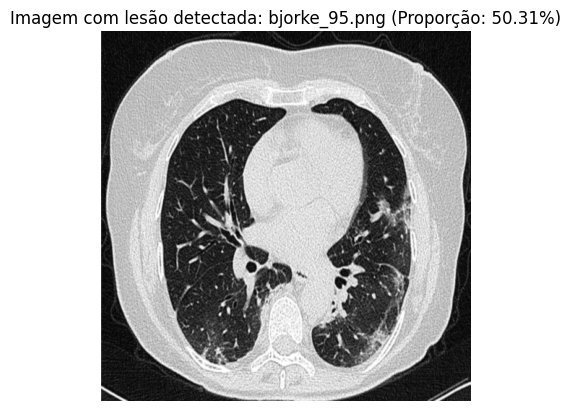

Imagem: bjorke_95.png, Lesão detectada: True, Proporção da lesão: 0.5031356811523438
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem: Jun_coronacases_case4_90.png, Lesão detectada: False, Proporção da lesão: 0.009853363037109375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


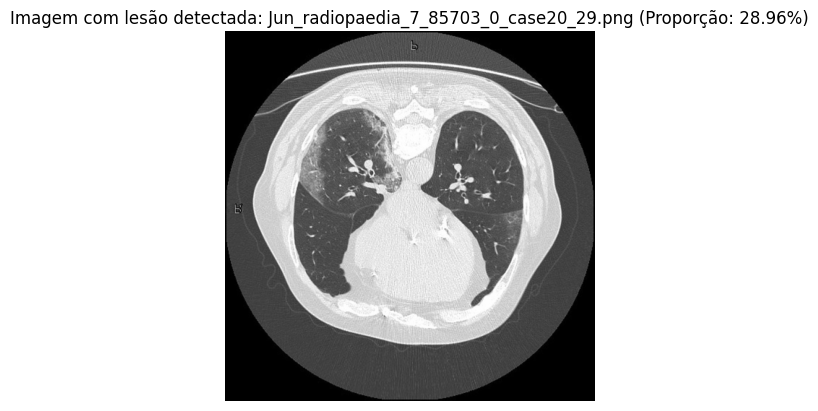

Imagem: Jun_radiopaedia_7_85703_0_case20_29.png, Lesão detectada: True, Proporção da lesão: 0.2895698547363281
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


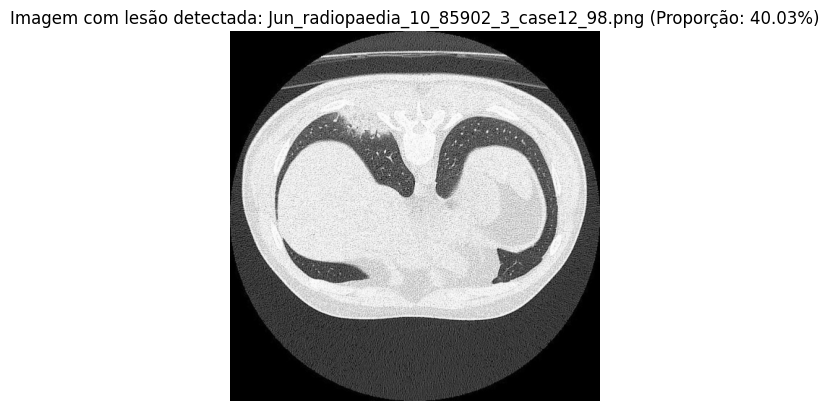

Imagem: Jun_radiopaedia_10_85902_3_case12_98.png, Lesão detectada: True, Proporção da lesão: 0.400299072265625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


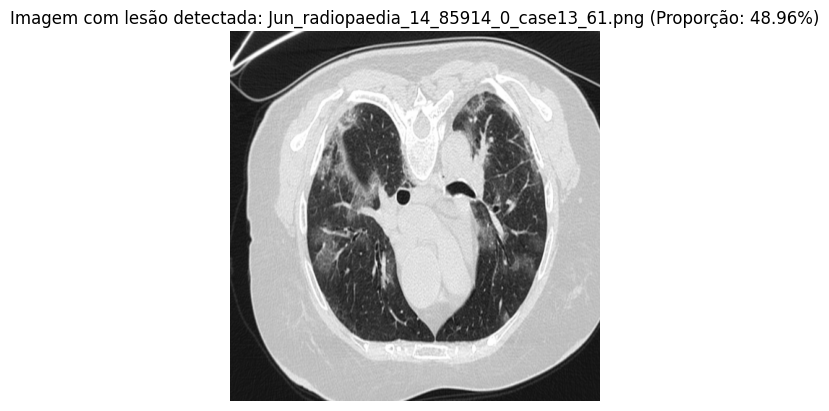

Imagem: Jun_radiopaedia_14_85914_0_case13_61.png, Lesão detectada: True, Proporção da lesão: 0.4895668029785156
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Imagem: Jun_coronacases_case8_110.png, Lesão detectada: False, Proporção da lesão: 0.003345489501953125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


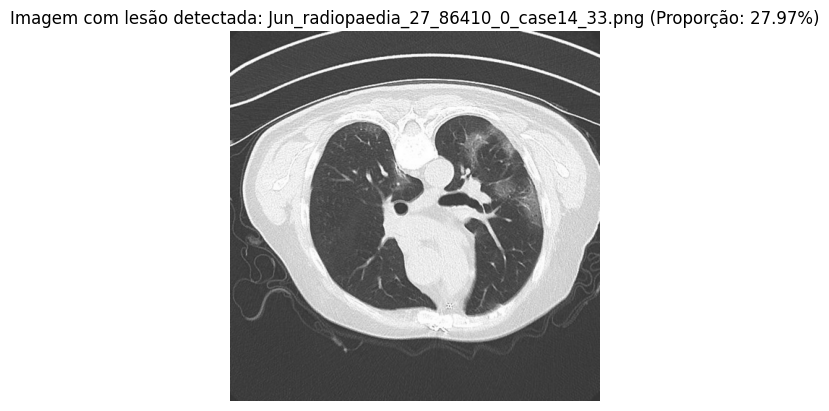

Imagem: Jun_radiopaedia_27_86410_0_case14_33.png, Lesão detectada: True, Proporção da lesão: 0.2797126770019531
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Imagem: Jun_coronacases_case8_253.png, Lesão detectada: False, Proporção da lesão: 0.0063018798828125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem: Morozov_study_0297_37.png, Lesão detectada: False, Proporção da lesão: 0.00167083740234375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Imagem: Jun_coronacases_case2_45.png, Lesão detectada: False, Proporção da lesão: 0.0014190673828125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


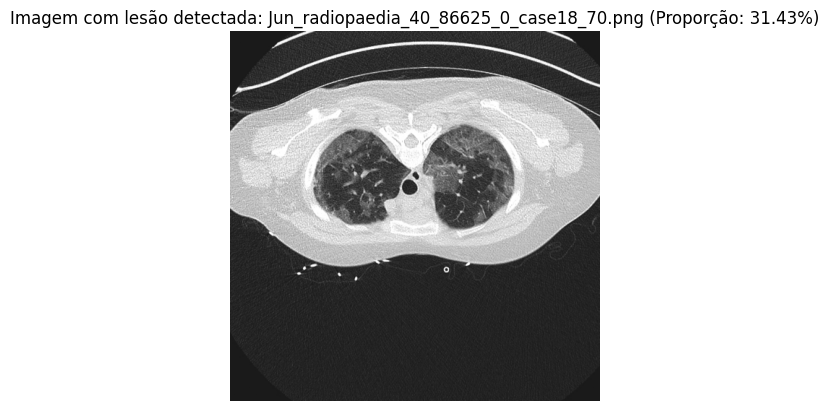

Imagem: Jun_radiopaedia_40_86625_0_case18_70.png, Lesão detectada: True, Proporção da lesão: 0.3143119812011719
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Imagem: Morozov_study_0304_16.png, Lesão detectada: False, Proporção da lesão: 0.003299713134765625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem: Jun_coronacases_case3_92.png, Lesão detectada: False, Proporção da lesão: 0.008159637451171875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Imagem: Jun_coronacases_case5_116.png, Lesão detectada: False, Proporção da lesão: 0.008823394775390625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Imagem: Morozov_study_0286_22.png, Lesão detectada: False, Proporção da lesão: 0.002231597900390625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


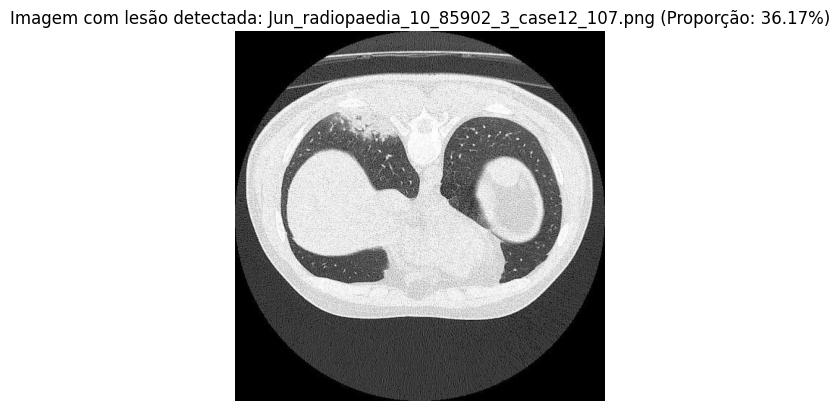

Imagem: Jun_radiopaedia_10_85902_3_case12_107.png, Lesão detectada: True, Proporção da lesão: 0.36174774169921875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Imagem: Jun_coronacases_case10_197.png, Lesão detectada: False, Proporção da lesão: 0.0026397705078125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Imagem: Jun_coronacases_case3_94.png, Lesão detectada: False, Proporção da lesão: 0.01169586181640625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem: Morozov_study_0270_16.png, Lesão detectada: False, Proporção da lesão: 0.000720977783203125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Imagem: Jun_coronacases_case1_143.png, Lesão detectada: False, Proporção da lesão: 0.009227752685546875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Imagem: Morozov_study_0270_11.png, Lesão detectada: False, Proporção da lesão: 0.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Imagem: Jun_coronacases_case10_208.png, Lesão detectada: False, Proporção da lesão: 0.00373077392578125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Imagem: Jun_coronacases_

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Inicializar o contador
lesions_detected_count = 0

# Selecionar apenas as primeiras 150 imagens
image_files = image_files[:150]

# Processar as imagens
for image_file in image_files:
    image_path = os.path.join(dataset_dir, image_file)
    image = preprocess_image(image_path)

    image = np.expand_dims(image, axis=0)  # Adiciona a dimensão de batch
    has_lesion, lesion_ratio = classify_lung(image, model)

    # Verificar se a lesão foi detectada
    if has_lesion:
        lesions_detected_count += 1  # Incrementa o contador se a lesão for detectada

        # Exibir a imagem
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.title(f'Imagem com lesão detectada: {image_file} (Proporção: {lesion_ratio:.2%})')
        plt.axis('off')  # Desativar os eixos para melhor visualização
        plt.show()

    print(f'Imagem: {image_file}, Lesão detectada: {has_lesion}, Proporção da lesão: {lesion_ratio}')

# Exibir o total de imagens com lesão detectada
print(f'Total de imagens com lesão detectada: {lesions_detected_count}')

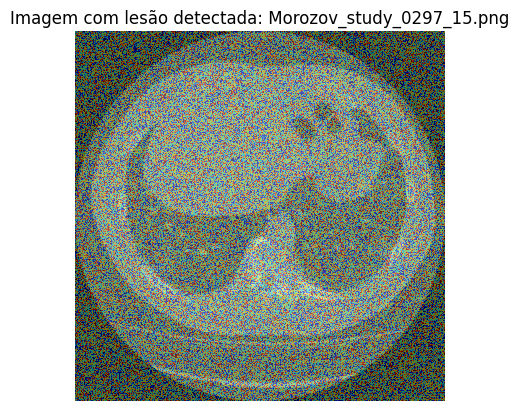

In [ ]:
## DESTACANDO A MASCARA QUE TEM LESAO


import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Suponha que `lesion_mask` seja uma máscara binária onde 1 é a lesão e 0 é a área saudável
lesion_mask = np.random.randint(0, 2, (512, 512))  # Exemplo de máscara

# Carregar a imagem
img = mpimg.imread(image_path)

# Exibir a imagem original
plt.imshow(img)

# Sobrepor a máscara da lesão (com transparência) sobre a imagem original
plt.imshow(lesion_mask, cmap='jet', alpha=0.5)  # A máscara será mostrada com uma transparência de 50%

plt.title(f'Imagem com lesão detectada: {image_file}')
plt.axis('off')  # Desativar os eixos para melhor visualização
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━

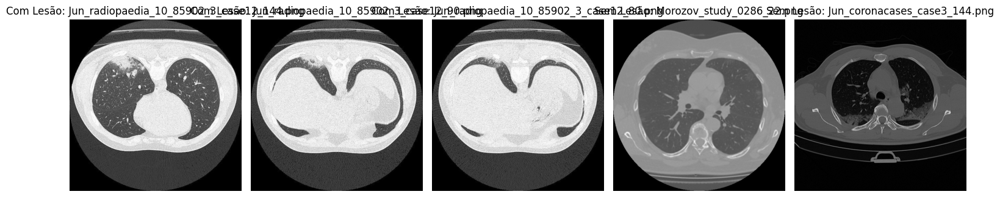

In [ ]:
import matplotlib.pyplot as plt
import random

# Listas para armazenar imagens com e sem lesão
images_with_lesion = []
images_without_lesion = []

# Processar as imagens e separar as com e sem lesão
for image_file in image_files[:150]:  # Limite para as primeiras 150 imagens
    image_path = os.path.join(dataset_dir, image_file)
    image = preprocess_image(image_path)

    ####
    image = np.expand_dims(image, axis=0)  # Adiciona a dimensão de batch

    has_lesion, lesion_ratio = classify_lung(image, model)

    if has_lesion:
        images_with_lesion.append((image_file, image_path))
    else:
        images_without_lesion.append((image_file, image_path))

# Selecionar aleatoriamente 3 imagens com lesão e 2 sem lesão
selected_with_lesion = random.sample(images_with_lesion, 3)
selected_without_lesion = random.sample(images_without_lesion, 2)

# Exibir as imagens selecionadas
fig, axes = plt.subplots(1, 5, figsize=(15, 5))

# Exibir as 3 imagens com lesão
for i, (image_file, image_path) in enumerate(selected_with_lesion):
    img = mpimg.imread(image_path)
    axes[i].imshow(img)
    axes[i].set_title(f"Com Lesão: {image_file}")
    axes[i].axis('off')

# Exibir as 2 imagens sem lesão
for i, (image_file, image_path) in enumerate(selected_without_lesion, start=3):
    img = mpimg.imread(image_path)
    axes[i].imshow(img)
    axes[i].set_title(f"Sem Lesão: {image_file}")
    axes[i].axis('off')

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━

error: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.simd_helpers.hpp:92: error: (-2:Unspecified error) in function 'cv::impl::{anonymous}::CvtHelper<VScn, VDcn, VDepth, sizePolicy>::CvtHelper(cv::InputArray, cv::OutputArray, int) [with VScn = cv::impl::{anonymous}::Set<1>; VDcn = cv::impl::{anonymous}::Set<3, 4>; VDepth = cv::impl::{anonymous}::Set<0, 2, 5>; cv::impl::{anonymous}::SizePolicy sizePolicy = cv::impl::<unnamed>::NONE; cv::InputArray = const cv::_InputArray&; cv::OutputArray = const cv::_OutputArray&]'
> Invalid number of channels in input image:
>     'VScn::contains(scn)'
> where
>     'scn' is 3


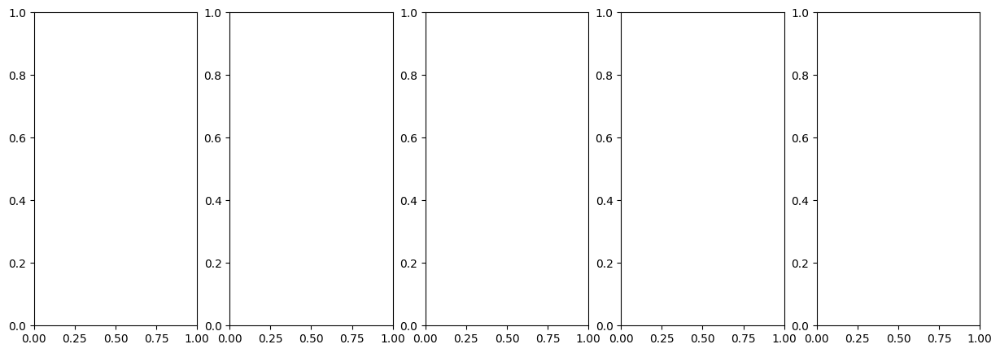

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import random
import cv2
import matplotlib.image as mpimg

# Função para desenhar um contorno na área da lesão
def highlight_lesion(image, lesion_mask):
    # Converter imagem para RGB para mostrar no Matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)

    # Aplica o contorno na máscara da lesão
    contours, _ = cv2.findContours(lesion_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cv2.drawContours(image_rgb, contours, -1, (0, 255, 0), 3)  # Desenha contornos verdes

    return image_rgb

# Listas para armazenar imagens com e sem lesão
images_with_lesion = []
images_without_lesion = []

# Processar as imagens e separar as com e sem lesão
for image_file in image_files[:150]:  # Limite para as primeiras 150 imagens
    image_path = os.path.join(dataset_dir, image_file)
    image = preprocess_image(image_path)

  ####
    image = np.expand_dims(image, axis=0)  # Adiciona a dimensão de batch

    has_lesion, lesion_ratio = classify_lung(image, model)

    if has_lesion:
        # Gerar a máscara de lesão (assumindo que o modelo retorna a máscara de lesão)
        lesion_mask = np.random.random(image.shape) > 0.5  # Exemplo, substitua pela máscara real
        images_with_lesion.append((image_file, image_path, lesion_mask))
    else:
        images_without_lesion.append((image_file, image_path))

# Selecionar aleatoriamente 3 imagens com lesão e 2 sem lesão
selected_with_lesion = random.sample(images_with_lesion, 3)
selected_without_lesion = random.sample(images_without_lesion, 2)

# Exibir as imagens selecionadas com destaque para a lesão
fig, axes = plt.subplots(1, 5, figsize=(15, 5))

# Exibir as 3 imagens com lesão
for i, (image_file, image_path, lesion_mask) in enumerate(selected_with_lesion):
    img = mpimg.imread(image_path)
    img_with_lesion = highlight_lesion(img, lesion_mask)  # Destacar lesão
    axes[i].imshow(img_with_lesion)
    axes[i].set_title(f"Com Lesão: {image_file}")
    axes[i].axis('off')

# Exibir as 2 imagens sem lesão
for i, (image_file, image_path) in enumerate(selected_without_lesion, start=3):
    img = mpimg.imread(image_path)
    axes[i].imshow(img)
    axes[i].set_title(f"Sem Lesão: {image_file}")
    axes[i].axis('off')

plt.tight_layout()
plt.show()
